# Team 6a - Final Project

## Title : 

US and Japan YouTube Trending Videos

## Problem: 
    
Our goal is to analyze US and Japan YouTube trending videos and identify preferences in video categories, channels, publishing and trending time and viewer interactions. We will analyze the characteristics including categories, view, likes count and trending time (season/weekday/month), in trending videos to identify and compare changes in preference over time. Moreover, we are interested to know if the country culture has an influence on the YouTube trending videos characteristics.

## Data source:

Initially, we had four different tables with the videos information and two tables that contain the video categories information. 


`ba775-team-6a.youtube.US_youtube_trending_data`,
`ba775-team-6a.youtube.US_youtube_trending_data_past`,
`ba775-team-6a.youtube.JP_youtube_trending_data`,
`ba775-team-6a.youtube.JP_youtube_trending_data_past`,
`ba775-team-6a.youtube.US_video_categories`,
`ba775-team-6a.youtube.JP_video_categories`

We decided to put all the information in one table which is the one that we will use in our analysis:

`ba775-team-6a.youtube.Youtube_trending_videos`

Also, we are using YouTube API to gather more video characteristics such as channel statistics, comments and playlists:

https://developers.google.com/youtube/v3/docs

## Reference to datasource:

This datasources were collected using the Youtube API and it presents a list of the top trending videos on the platform. To determine the year's top-trending videos, Youtube uses a combination of factors such as number of views, shares, comments and likes. We accessed the datasources via Kaggle data notebooks  "Trending Yotube Video Statistics" and "YouTube Trending Video Dataset".

YouTube API's documentation:
https://developers.google.com/youtube/v3/docs

Links: 

https://www.kaggle.com/datasnaek/youtube-new

https://www.kaggle.com/rsrishav/youtube-trending-video-dataset

## Outline
1. Load data

2. YouTube User Interactions Analysis

3. YouTube Categories Analysis

4. YouTube Videos Analysis

5. Correlation between Categories and Top Videos

7. YouTube Channels Analysis

## 1. Load Data

In [1]:
! pip install wordcloud
! pip install pillow
! pip install plotly

In [2]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import datetime as dt
import plotly.express as px
import warnings
import numpy as np
warnings.filterwarnings('ignore')

import wordcloud
from collections import Counter
from wordcloud import WordCloud, STOPWORDS


sns.set(rc={'figure.figsize':(20,10)})


In [3]:
df = pd.read_csv("YouTube_trending_videos.csv")

youtube_jp = df.loc[df['Country']=='Japan']
youtube_us = df.loc[df['Country']=='United States']

In [ ]:
df.head(3)

,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,view_count,likes,dislikes,comment_count,comments_disabled,ratings_disabled,description,Category_name,Country
0,T7Ux7BbkPDw,発表！全ガンダム大投票 第１部＆第２部 ５月５日（土）,2018-05-06 18:18:16 UTC,NaN,a,1,2018-05-12 00:00:00 UTC,10428,93,3,3,False,False,NaN,Film & Animation,Japan
1,m0zFDr69XFI,【ゆっくり実況】 PCぶっ壊れたかと思ったホラーゲーム Repeat 【ホラーゲーム】,2018-03-11 14:58:55 UTC,NaN,AZ,20,2018-03-12 00:00:00 UTC,6560,99,13,48,False,False,強制終了したり固まったり紛らわしいんじゃ～,Gaming,Japan
2,33xKehpPEd4,シャンシャン 飼育員さんとおにごっこ♪,2018-04-16 08:00:02 UTC,NaN,BG,15,2018-04-17 00:00:00 UTC,15395,180,14,13,False,False,ジャイアントパンダのシャンシャン \nママがいなくなった庭で飼育員さんとおにごっこ\n\n庭...,Pets & Animals,Japan


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71868 entries, 0 to 71867
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   video_id           71868 non-null  object
 1   title              71868 non-null  object
 2   publishedAt        71868 non-null  object
 3   channelId          26794 non-null  object
 4   channelTitle       71868 non-null  object
 5   categoryId         71868 non-null  int64 
 6   trending_date      71868 non-null  object
 7   view_count         71868 non-null  int64 
 8   likes              71868 non-null  int64 
 9   dislikes           71868 non-null  int64 
 10  comment_count      71868 non-null  int64 
 11  comments_disabled  71868 non-null  bool  
 12  ratings_disabled   71868 non-null  bool  
 13  description        69733 non-null  object
 14  Category_name      71850 non-null  object
 15  Country            71868 non-null  object
dtypes: bool(2), int64(5), object(9)
memory u

In [ ]:
print(f'The YouTube Trending dataset has {df.shape[0]} rows and {df.shape[1]} columns')

The YouTube Trending dataset has 71868 rows and 16 columns


### Data cleaning

The dataset have null values in the columns "channelId", "description" , and "category_name". The channel id has missing values because 2018 datasets (`ba775-team-6a.youtube.JP_youtube_trending_data_past`, `ba775-team-6a.youtube.US_youtube_trending_data_past`) didn't have that information. However, we decided to include this column because we need this unique channel id to retrieve information from the YouTube API. 

In [4]:
df['description'] = df['description'].fillna(" ") ##Data imputation for description
df['channelId'] = df['channelId'].fillna(" ") ##Data imputation for channel id
df['Category_name'] = df['Category_name'].fillna(" ") ##Data imputation for Category_name

We added new columns to our dataset to help in our analysis

In [5]:
df['publish_year'] = pd.DatetimeIndex(df['publishedAt']).year
df['publish_time'] = pd.to_datetime(df['publishedAt']).dt.time
df['publish_datetime'] = pd.to_datetime(df['publishedAt'])
df['trending_datetime'] = pd.to_datetime(df['trending_date'])
df['days_to_go_trending'] = df['trending_datetime'] - df['publish_datetime']

df[['publish_year','publish_time','publish_datetime','trending_date','days_to_go_trending']].head(3)

,publish_year,publish_time,publish_datetime,trending_date,days_to_go_trending
0,2018,18:18:16,2018-05-06 18:18:16+00:00,2018-05-12 00:00:00 UTC,5 days 05:41:44
1,2018,14:58:55,2018-03-11 14:58:55+00:00,2018-03-12 00:00:00 UTC,0 days 09:01:05
2,2018,08:00:02,2018-04-16 08:00:02+00:00,2018-04-17 00:00:00 UTC,0 days 15:59:58


### Getting to know our dataset

In [ ]:
df.pivot_table(values='view_count', index='publish_year', columns='Country', aggfunc='mean')

Country,Japan,United States
publish_year,,
2018,2.537513e+05,2.740231e+06
2020,1.421849e+06,2.688567e+06


In [ ]:
#  how many videos infomation we have per trending day in our dataset
tmp1=  int(round(df.groupby('trending_datetime').size().mean(),0))
tmp2= len(df['trending_datetime'].unique())
tmp3 = len(df['video_id'].unique())

print(f'On average, we have data on about {tmp1} trending videos per day for a total of {tmp2} days.')
print(f'There are {tmp3} distinct videos to analyze in our dataset. A lot of videos stayed on the trending list for multiple days.')

On average, we have data on about 318 trending videos per day for a total of 226 days.
There are 21617 distinct videos to analyze in our dataset. A lot of videos stayed on the trending list for multiple days.


In [ ]:
youtube_us.groupby('trending_date').size().std()
tmp= round(youtube_us.groupby('trending_date').size().mean(),2)

print(f' According to our dataset, for U.S videos, there were {tmp} videos promoted on YouTube trending list each day on average.' )

 According to our dataset, for U.S videos, there were 195.58 videos promoted on YouTube trending list each day on average.


In [ ]:
youtube_jp.groupby('trending_date').size().std()
tmp= round(youtube_jp.groupby('trending_date').size().mean(),0)

print(f'According to our dataset, for Japan videos, there were {tmp} videos promoted on YouTube trending list each day on average. ' )

According to our dataset, for Japan videos, there were 150.0 videos promoted on YouTube trending list each day on average. 


<AxesSubplot:xlabel='trending_datetime'>

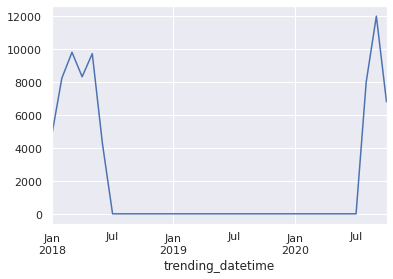

In [ ]:
# The datasets were collected from Jan.2018 to Jul.2018 and from Jul.2020 to Oct.2020.

%matplotlib inline

youtube = df.set_index('trending_datetime').copy()

size = youtube.resample("M").size()

size.plot(kind='line')

## 2. YouTube User Interactions Analysis

###User Interaction PART 1 - Interaction features 

We are interested in knowing more about YouTube viewer behavior, so we dive deeper into the viewer interaction features, which contain views count, likes count ,dislikes count and comments count. 


 > a )To start off, let's analyze video view counts based on time series analysis

In [ ]:
# We subset the data into two groups: 2018 and 2020
youtube_2018 = youtube.loc['2018-01-01':"2018-07-01"]
youtube_2020 = youtube.loc['2018-08-01':"2020-11-01"]

[Text(0.5, 0, 'Trending Month'),
 Text(0, 0.5, 'Average view counts'),
 Text(0.5, 1.0, 'Average Trending View Counts in 2018')]

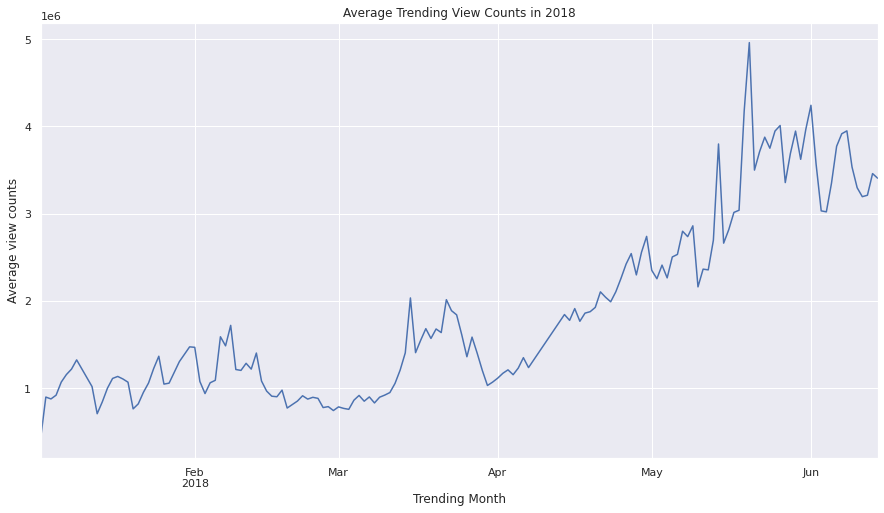

In [ ]:
# Time series analysis for 2018 
sns.set(rc={'figure.figsize':(15,8)})

timeseries_2018 = youtube_2018['view_count'].resample('D').mean().interpolate().plot()
timeseries_2018.set(xlabel='Trending Month',ylabel='Average view counts', title='Average Trending View Counts in 2018')

[Text(0.5, 0, 'Trending Month'),
 Text(0, 0.5, 'Average view counts'),
 Text(0.5, 1.0, 'Average Trending View Counts in 2020')]

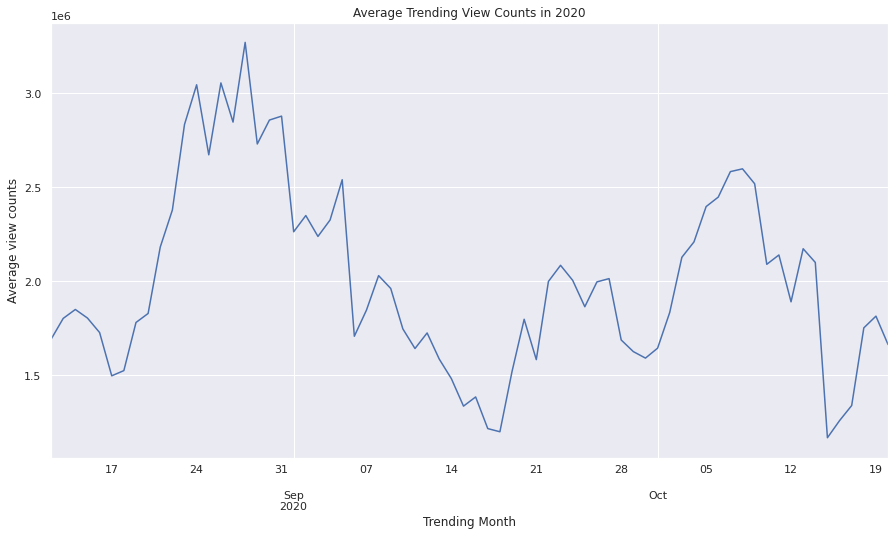

In [ ]:
# Time series analysis for 2020
sns.set(rc={'figure.figsize':(15,8)})

timeseries_2020 = youtube_2020['view_count'].resample('D').mean().interpolate().plot()
timeseries_2020.set(xlabel='Trending Month',ylabel='Average view counts', title='Average Trending View Counts in 2020')

> b)  Statistics and Disribution of each features: views, likes, disliks,and comments.

In [ ]:
#  statistics for views and likes 

max_view_count = df['view_count'].max() 
min_view_count = df['view_count'].min()

print(f' For trending videos, the max views count is {max_view_count} and min views count is {min_view_count}.')


v_avg= round(df['view_count'].mean(),0)
v_m = round(df['view_count'].median(),0)
print(f' For the YouTube trending videos, the mean of view count is {v_avg}, the median is {v_m}')

l_avg= round(df['likes'].mean(),0)
l_m = round(df['likes'].median(),0)
r_view_to_likes= round(l_avg/v_avg,2)

print(f' For the YouTube trending videos, the mean of likes count is {l_avg}, the median is {l_m}')
print(f' The ratio of likes count to views count is {r_view_to_likes}')

 For trending videos, the max views count is 262319276 and min views count is 549.
 For the YouTube trending videos, the mean of view count is 1960727.0, the median is 511159.0
 For the YouTube trending videos, the mean of likes count is 82912.0, the median is 13232.0
 The ratio of likes count to views count is 0.04


In [ ]:
#  statistics for comments count and views count

c_avg= round(df['comment_count'].mean(),0)
c_m = round(df['comment_count'].median(),0)
r_comment_to_views =round(c_avg/v_avg,2)
print(f' For the YouTube trending videos, the mean of comment count is {c_avg}, the median is {c_m}')
print(f' The ratio of comments counts to view counts is {r_comment_to_views}')


 For the YouTube trending videos, the mean of comment count is 10137.0, the median is 1383.0
 The ratio of comments counts to view counts is 0.01


In [ ]:
#  statistics for dislikes count and views count

dis_avg= round(df['dislikes'].mean(),0)
dis_m = round(df['dislikes'].median(),0)
r_dis_to_view =round(dis_avg/v_avg,4)

print(f' For the YouTube trending videos, the mean of dislikes count is {dis_avg}, the median is {dis_m}')
print(f' The ratio of dislikes count to view counts is {r_dis_to_view}')

 For the YouTube trending videos, the mean of dislikes count is 3004.0, the median is 405.0
 The ratio of dislikes count to view counts is 0.0015


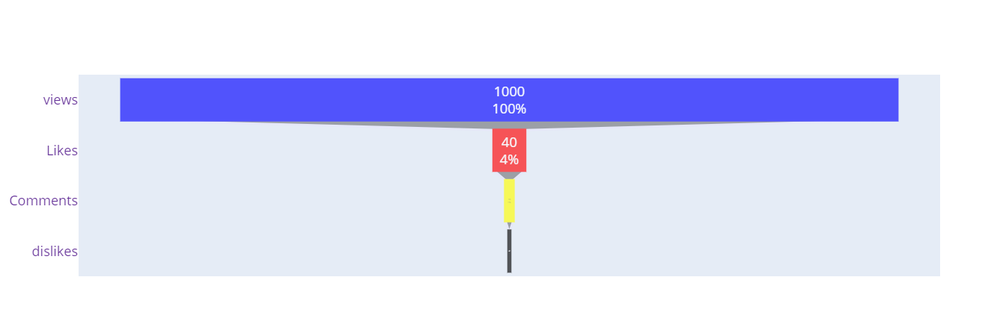

In [ ]:
from plotly import graph_objects as go


fig = go.Figure(go.Funnel(
    y = ["views","Likes", "Comments",'dislikes'],
    x = [1000,40,10,1.5],
    textposition = "inside",
    textinfo = "value+percent initial",
    opacity = 0.65, marker = {"color": ["blue", "red", "yellow", "black"],
    "line": {"width": [4, 4, 4, 4], "color": ["blue", "red", "yellow", "black"]}},
    connector = {"line": {"color": "lavender", "dash": "solid", "width": 3}})
    )

fig.update_layout(
    font=dict(
        size=18,
        color="RebeccaPurple")
)
fig.show()

On average, YouTubers should expect a 4% like to view ratio, and 1% comment to view ratio.

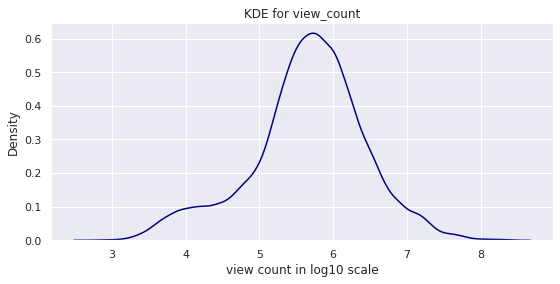

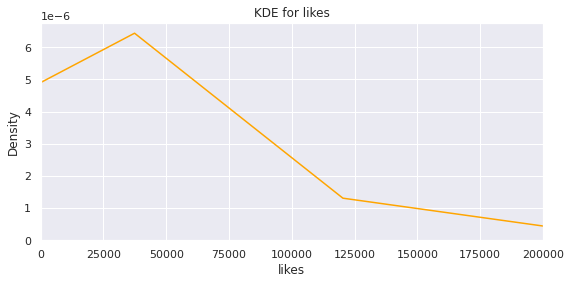

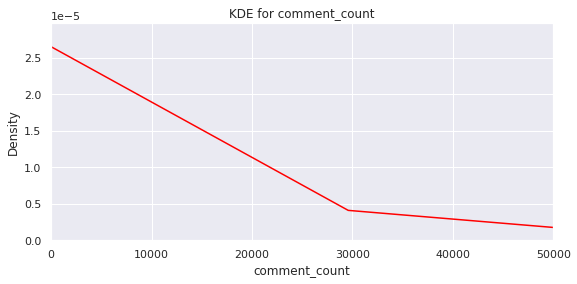

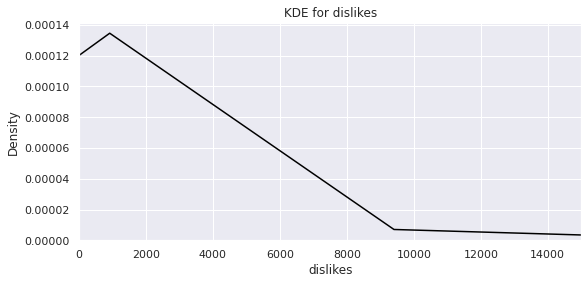

In [ ]:
# Visualize the probablity density distribution for the features of interest

def kdeplot(feature):
    plt.figure(figsize=(9, 4))
    plt.title("KDE for {}".format(feature))
    if feature =='view_count':
      g=sns.kdeplot(np.log10(df[feature].copy()), color= 'navy', label= 'views (log10 scale)')
      g.set(xlabel='view count in log10 scale')
    if feature =='likes':
      sns.kdeplot(df[feature], color= 'orange', label= 'likes')
      plt.xlim(0,200000)

    if feature =='comment_count':
      sns.kdeplot(df[feature], color= 'red', label= 'comments')
      plt.xlim(0,50000)

    if feature =='dislikes':
      sns.kdeplot(df[feature], color= 'black', label= 'dislikes')
      plt.xlim(0,15000)


kdeplot('view_count')
kdeplot('likes')
kdeplot('comment_count')
kdeplot('dislikes')

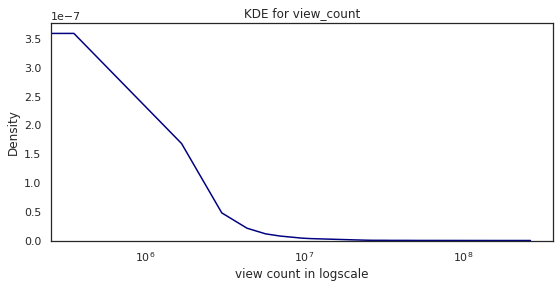

In [ ]:
# using g.set_xscale('log') to display the distribution of view count in scientific notation format
# Getting an idea of where the greatest view count lies in the distribution

sns.set_style("white")
def kdeplot(feature):
    plt.figure(figsize=(9, 4))
    plt.title("KDE for {}".format(feature))
    if feature =='view_count':
      g=sns.kdeplot(df[feature], color= 'navy', label= 'views (log scale)')
      g.set(xlabel='view count in logscale')
      g.set_xscale('log')


kdeplot('view_count')

Observation: 

The majority of videos have view counts ranging from 100k - 1M. 



> c ) The relationships among the features of interest (view count, likes, dislikes, comment counts).

<AxesSubplot:>

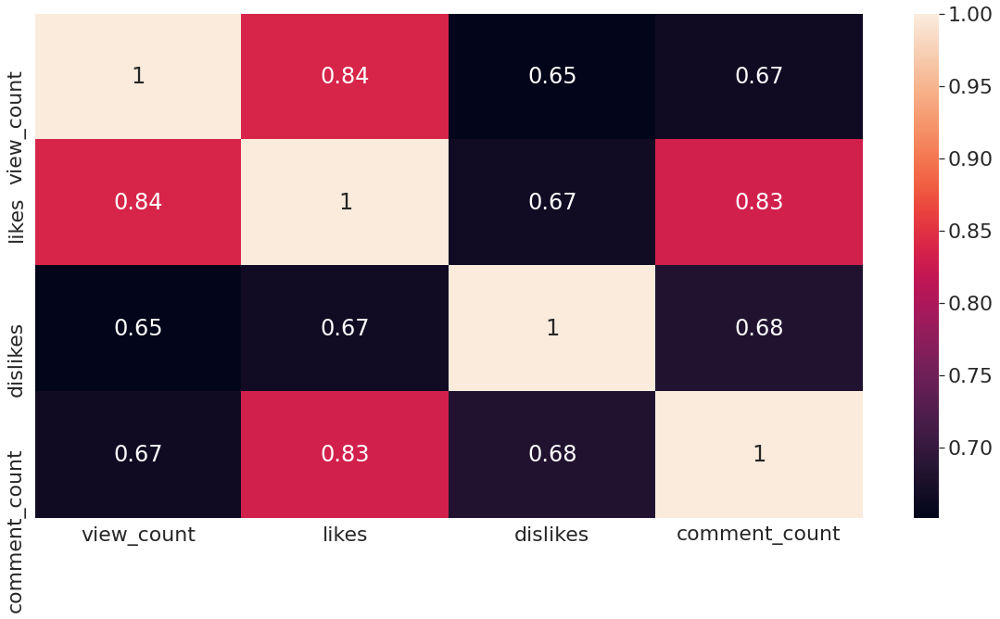

In [ ]:
# create a correlation heatmap
%matplotlib inline
sns.set(rc={'figure.figsize':(20,10)})
sns.set(font_scale = 2)

factor=['view_count','likes',	'dislikes','comment_count']

df[factor].corr()

sns.heatmap(df[factor].corr(), annot=True, xticklabels=factor, yticklabels=factor)

# create scatterplot for view counts , number of likes, and comment counts

sns.set_style("white")
sns.set_context("talk")

v= sns.relplot(data=df,x='view_count',y='likes',size='comment_count',kind='scatter' )
v.set(xlabel= 'view count',ylabel='number of likes',title='Scatterplot')

plt.show()

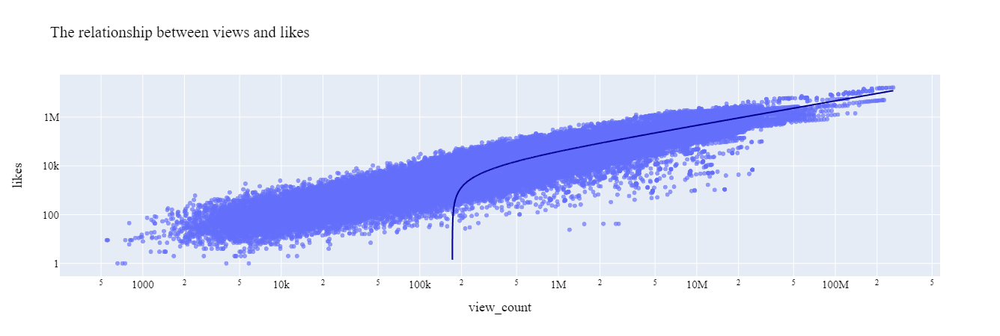

In [ ]:
# Since we learn from the correlation heatmap that view counts and like count are highly correlated, we create a scatterplot to further examine the linear relationship between these features.
%matplotlib inline

fig = px.scatter(
    df, x='view_count', y ='likes', opacity=0.65, log_x=True, log_y=True,
    trendline='ols', trendline_color_override='darkblue',title='The relationship between views and likes')


fig.update_layout(
    font=dict(
        family="Muli Bold Bold",
        size=15,
        color="Black")
    )

fig.show()

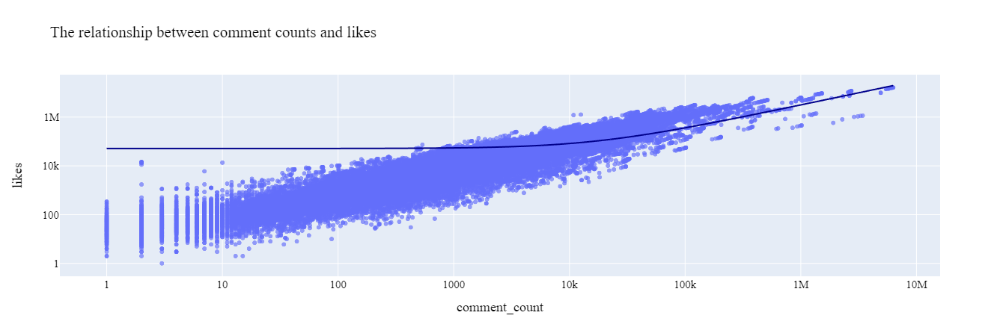

In [ ]:
# comments count and likes count also show a postive linear relationship 


fig = px.scatter(
    df, x='comment_count', y ='likes', opacity=0.65, log_x=True, log_y=True,
    trendline='ols', trendline_color_override='darkblue',title='The relationship between comment counts and likes')


fig.update_layout(
    font=dict(
        family="Muli Bold Bold",
        size=15,
        color="Black")
)
fig.show()

Not surprisingly, views and likes show a fairly strong postive correlation. Comment count and Likes are also strongly correlated.

Now, let's consider the differences between Japan and U.S viewers in terms of user interaction features(view counts, likes, comment counts, and dislikes).

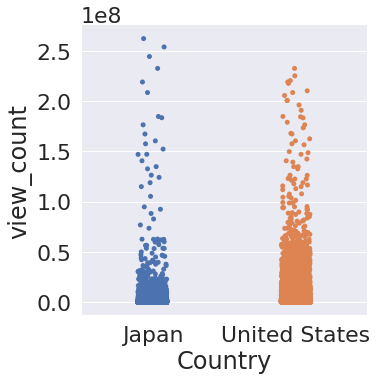

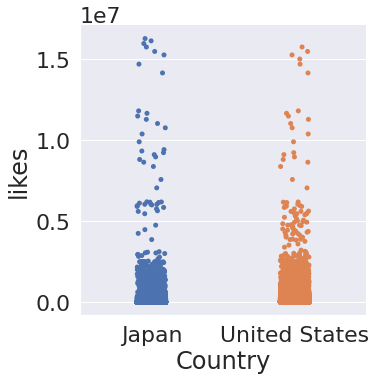

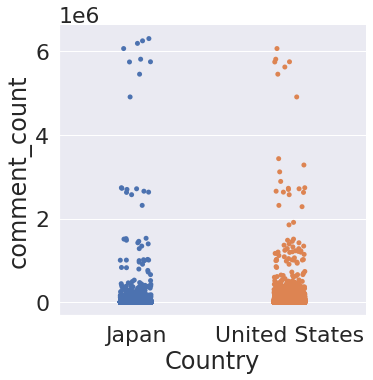

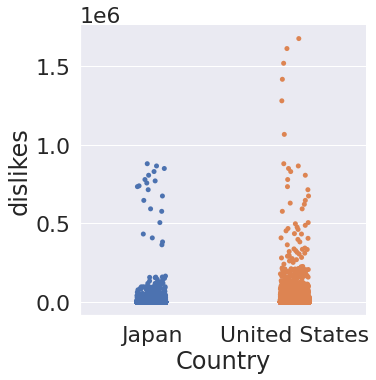

In [ ]:

sns.catplot(data=df,x='Country',y='view_count',hue='Country',kind='strip')
sns.catplot(data=df,x='Country',y='likes',hue='Country',kind='strip')
sns.catplot(data=df,x='Country',y='comment_count',hue='Country',kind='strip')
sns.catplot(data=df,x='Country',y='dislikes',hue='Country',kind='strip')

plt.show()

Observation:

*   The distributions for comments count are quite similar for Japan and U.S 
*   U.S vidoes tend to have a higher view count and likes count than Japan videos.
*   U.S videos tend to receive more dislikes counts compared to Japan videos



###User Interactions Part 2 : Views and Trending duration 

Through our previous Bigquery analysis, we figured out Japanese views tend to update their trending list faster than U.S viewers. This time, we did further analysis on trending duration to see how trending duration reflects the culture differences and how it relate to view counts.

In [ ]:
# For U.S videos, what kinds of vidoes had longer trending duration and how many trending days they had?

youtube_us_td = youtube_us[youtube_us['video_id'] != '#NAME?'].groupby(['video_id']).size().reset_index(name='trending_duration')\
.sort_values('trending_duration',ascending=False)

youtube_us_tmp = youtube_us[['video_id','title','channelTitle','Category_name','view_count']]

youtube_us_tmp1= youtube_us_td.merge(youtube_us_tmp, on='video_id', how='left')\
.sort_values(by=['trending_duration', 'view_count'], ascending= False)

youtube_us_withtd = youtube_us_tmp1.drop_duplicates(subset=['video_id'],keep='first')


us_td_top10 = youtube_us_withtd.head(20)
us_td_top10


,video_id,trending_duration,title,channelTitle,Category_name,view_count
32,8h--kFui1JA,29,Sam Smith - Pray (Official Video) ft. Logic,SamSmithWorldVEVO,Music,20934803
28,j4KvrAUjn6c,29,WE MADE OUR MOM CRY...HER DREAM CAME TRUE!,Lucas and Marcus,Entertainment,10381263
270,ulNswX3If6U,28,Selena Gomez - Back To You (Lyric Video),Selena Gomez,Film & Animation,54863912
337,MAjY8mCTXWk,28,"周杰倫 Jay Chou【不愛我就拉倒 If You Don't Love Me, It's...",杰威爾音樂 JVR Music,Music,21957640
151,6S9c5nnDd_s,28,Bohemian Rhapsody | Teaser Trailer [HD] | 20th...,20th Century Fox,Film & Animation,13619534
105,iILJvqrAQ_w,28,Charlie Puth - BOY [Official Audio],Charlie Puth,Music,10565823
136,r-3iathMo7o,28,"The ULTIMATE $30,000 Gaming PC Setup",Unbox Therapy,Science & Technology,6995168
295,YI3tsmFsrOg,28,The Deadliest Being on Planet Earth – The Bact...,Kurzgesagt – In a Nutshell,Education,4705269
226,t4pRQ0jn23Q,28,YoungBoy Never Broke Again Goes Sneaker Shoppi...,Complex,Entertainment,4654027
223,QBL8IRJ5yHU,28,Why I'm So Scared (being myself and crying too...,grav3yardgirl,Howto & Style,3811648


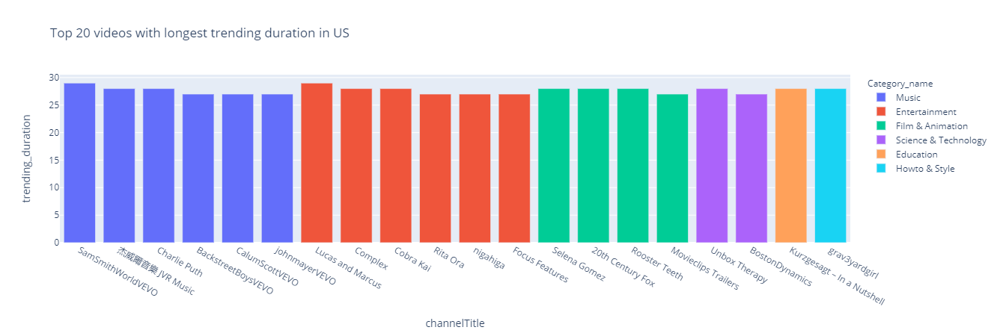

In [ ]:

fig= px.bar(us_td_top10, x= 'channelTitle', y= 'trending_duration',color='Category_name',title='Top 20 videos with longest trending duration in US')
fig.show()

In [ ]:
# ForJapan videos, what kinds of vidoes had longer trending duration and how many trending days they had?

youtube_jp_td = youtube_jp[youtube_jp['video_id'] != '#NAME?'].groupby(['video_id']).size().reset_index(name='trending_duration')\
.sort_values('trending_duration',ascending=False)
youtube_jp_tmp = youtube_jp[['video_id','title','channelTitle','Category_name','view_count']]

youtube_jp_tmp1= youtube_jp_td.merge(youtube_jp_tmp, on='video_id', how='left')\
.sort_values(by=['trending_duration', 'view_count'], ascending= False)

youtube_jp_withtd = youtube_jp_tmp1.drop_duplicates(subset=['video_id'],keep='first')


jp_td_top10 = youtube_jp_withtd.head(20)
jp_td_top10

,video_id,trending_duration,title,channelTitle,Category_name,view_count
1,yVDvw_gNbss,11,【ご報告】ンダホ、子どもが産まれていました！,Fischer's-フィッシャーズ-,Entertainment,6809498
204,gdZLi9oWNZg,10,BTS (방탄소년단) 'Dynamite' Official MV,Big Hit Labels,Music,262319276
152,dyRsYk0LyA8,10,BLACKPINK – ‘Lovesick Girls’ M/V,BLACKPINK,Music,152325542
21,CN4fffh7gmk,10,[CHOREOGRAPHY] BTS (방탄소년단) 'Dynamite' Dance Pr...,BANGTANTV,Music,28333304
173,QqsvrV1_XEA,10,IZ*ONE (아이즈원) - 'Beware' MV,official IZ*ONE,Entertainment,4671502
94,r-4XumkB2Yg,10,ReoNa - ANIMA / THE FIRST TAKE,THE FIRST TAKE,Music,4211682
72,9CTbic4nju4,10,カワウソさくら 消えた猫を必死で探し回り見つけた反応がすごいカワウソ otter look...,ma ko,Pets & Animals,2561621
18,cUHAY6WRhwo,10,日向坂46 「ひなリハ」～アザトカワイイ～,日向坂46 OFFICIAL YouTube CHANNEL,Music,1924924
217,gfC2hMxwNKs,10,石になるスプレーで石化してみた【恐怖のドッキリ】,SUSHI RAMEN【Riku】,Entertainment,1920962
143,-nsM3co7A-o,10,ナイトプールで1万円使い切るまで帰れません！！！【ねお】,スカイピースの平和島,People & Blogs,1722611


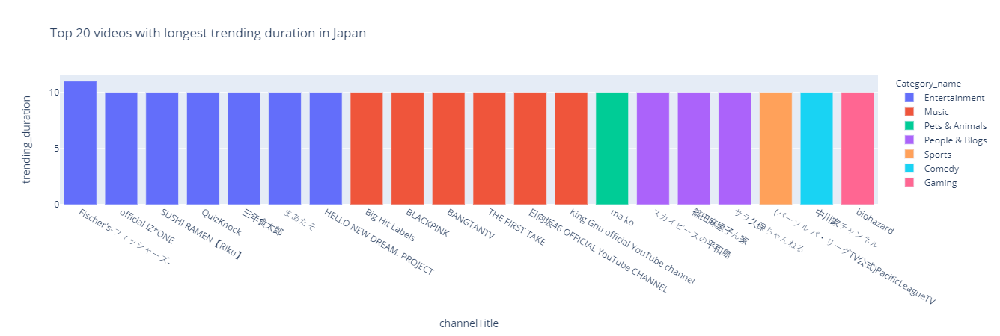

In [ ]:
fig= px.bar(jp_td_top10, x= 'channelTitle', y= 'trending_duration',color='Category_name',title='Top 20 videos with longest trending duration in Japan')
fig.show()

In [ ]:
#  For U.S videos, what is the proportion of videos that have multiple trending days? 
multiple_trending_days_us =youtube_us_withtd[youtube_us_withtd['trending_duration']> 1]
one_trending_day_us = youtube_us_withtd[youtube_us_withtd['trending_duration'] == 1]

ratio_us = youtube_us_withtd[youtube_us_withtd['trending_duration']> 1].video_id.count() / youtube_us_withtd.video_id.count()
ratio_us= round(ratio_us,3)

#  For Japan videos, what is the proportion of videos that have multiple trending days?

multiple_trending_days_jp =youtube_jp_withtd[youtube_jp_withtd['trending_duration']> 1]
one_trending_day_jp = youtube_jp_withtd[youtube_jp_withtd['trending_duration'] == 1]

ratio_jp = youtube_jp_withtd[youtube_jp_withtd['trending_duration']> 1].video_id.count() / youtube_jp_withtd.video_id.count()
ratio_jp= round(ratio_jp,2)


print(f'For U.S videos, the ratio of the number of mutiple-days-trending-videos to the number of all the videos is {ratio_us}. For Japan videos, the ratio is {ratio_jp}')

For U.S videos, the ratio of the number of mutiple-days-trending-videos to the number of all the videos is 0.925. For Japan videos, the ratio is 0.25


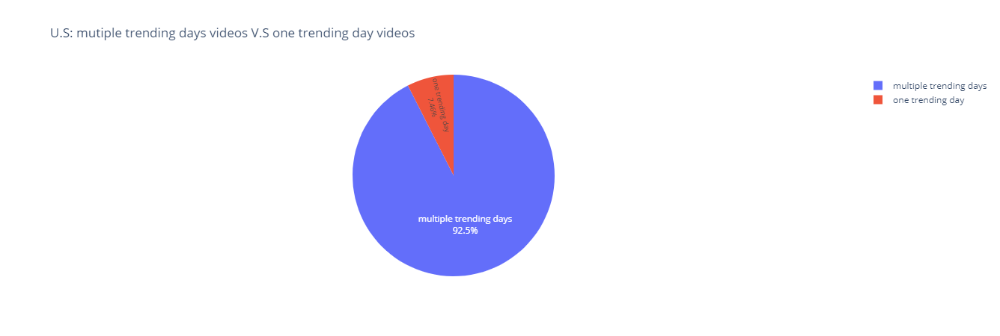

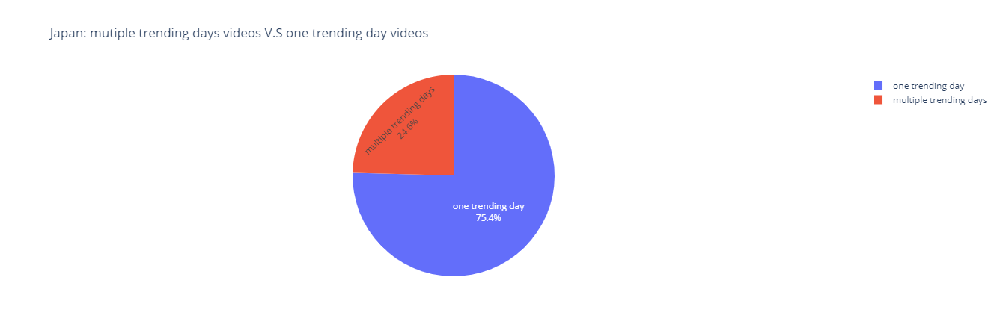

In [ ]:
multiple_trending_days_us['trending_period']='multiple trending days'
one_trending_day_us['trending_period']='one trending day'

m = pd.concat([multiple_trending_days_us,one_trending_day_us])
fig= px.pie(m,names='trending_period',labels='trending_duration' ,title="U.S: mutiple trending days videos V.S one trending day videos",hover_data=['trending_duration'])
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()


multiple_trending_days_jp['trending_period']='multiple trending days'
one_trending_day_jp['trending_period']='one trending day'

m = pd.concat([multiple_trending_days_jp,one_trending_day_jp])
fig= px.pie(m,names='trending_period',labels='trending_duration' ,title="Japan: mutiple trending days videos V.S one trending day videos",hover_data=['trending_duration'])
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

Let's look at the relationship between trending duartion and view counts. 


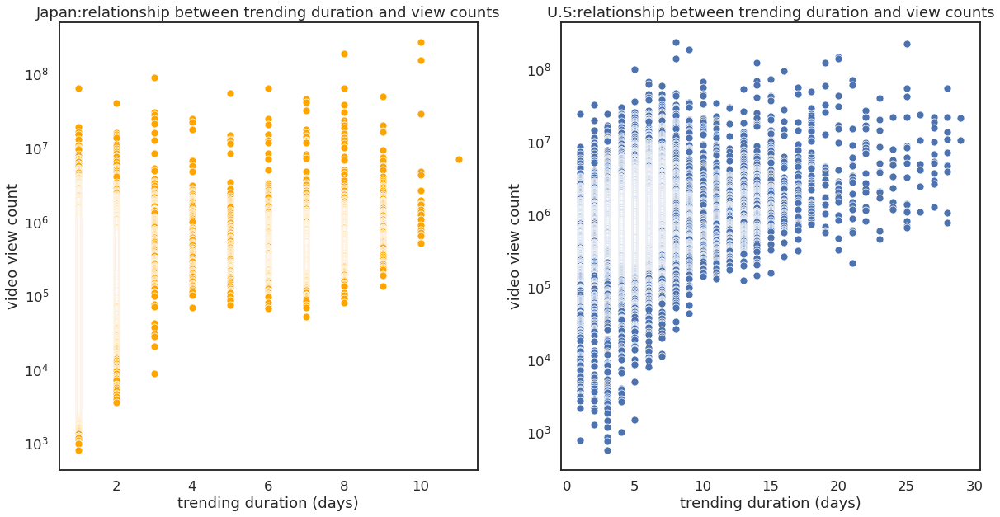

In [ ]:
sns.set_style("white")


fig,(ax1,ax2) =plt.subplots(nrows=1,ncols=2)

TD_jp = sns.scatterplot(data=youtube_jp_withtd, x = 'trending_duration', y='view_count', color='orange',ax=ax1)
TD_jp.set(xlabel='trending duration (days)', ylabel='video view count', title= 'Japan:relationship between trending duration and view counts')
TD_jp.set(yscale='log')


TD_us = sns.scatterplot(data=youtube_us_withtd, x = 'trending_duration', y= 'view_count',ax=ax2)
TD_us.set(xlabel='trending duration (days)', ylabel='video view count', title= 'U.S:relationship between trending duration and view counts')
TD_us.set(yscale='log')

plt.show()



**A finding regarding the relationship between trending duartion and views:**

Interstingly, not all the YouTube trending videos need to have high amount of views to hit the trending tab. For example, the minimum view count in our trending videos dataset is 549.  Even though view count serves as a major factor utilized by YouTube to promote videos to large audiences on its trending list, it's not the only factor. YouTube also takes into account several other factorsm, such as:

* Are the videos appealing to a wide range of viewers ? 
* Are the content not misleading, clickbaity or sensational? 
* Do the videos capture the breadth of what’s happening on YouTube and in the world ? 


However, we also notice that only the videos with massive views can stay on the trending lists for longer period. Considering view count is culmulative, this finding seems to be reasonable. Another reason is that YouTube also promotes those videos that can generate views quickly. 

###User Interaction Part 3 : Title and Description 

*  Videos titles play an important role in helping the videos get found by 
viewers. They describe the video and allow people to decide whether to click on the video. The video descriptions help channel owners convey more information to their audience. 

*  To have a better understanding of the viewer and channel owner's behaviors, we decided to do some text analysis on top of the numerical values analysis. We are interested in knowing what kind of titles and descriptions are most popular among YouTube trending videos, so we created wordclouds to understand the most commonly used words in video titles and descriptions. 

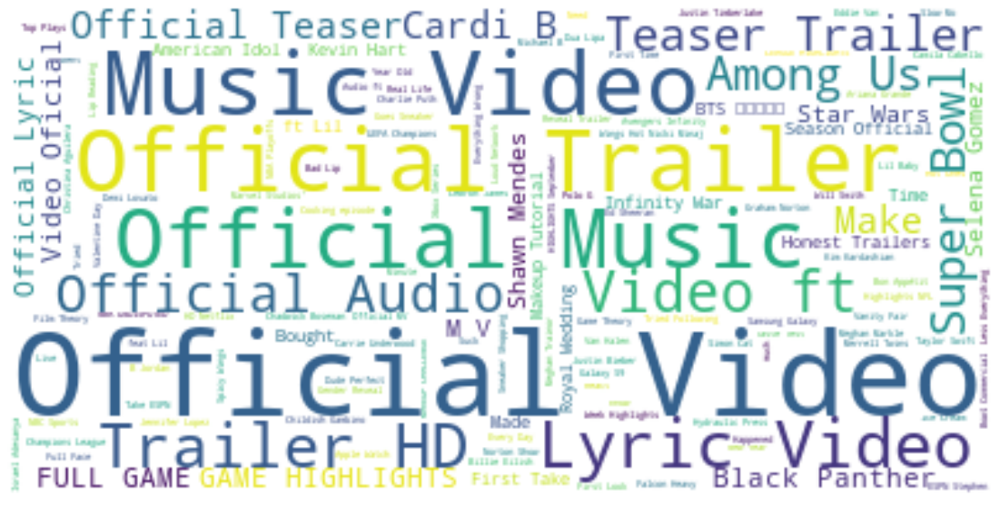

In [ ]:
# U.S: Most common words in video titles 

sns.set(rc={'figure.figsize':(20,10)})

text = youtube_us['title'].copy()
wordcloud = WordCloud(stopwords=STOPWORDS,max_font_size=50, max_words=1000, background_color="white").generate(' '.join(t for t in text))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()



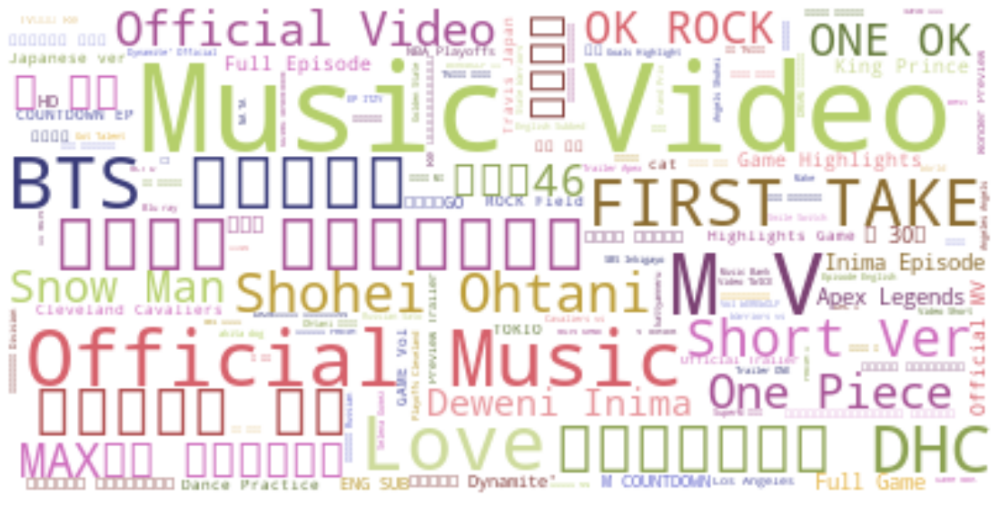

In [ ]:
# Japan: Most common words in video titles 
text = youtube_jp['title']
sns.set(rc={'figure.figsize':(20,10)})

wordcloud = WordCloud(stopwords=STOPWORDS,max_font_size=50, max_words=1000, background_color="white",colormap= 'tab20b').generate(' '.join(t for t in text))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

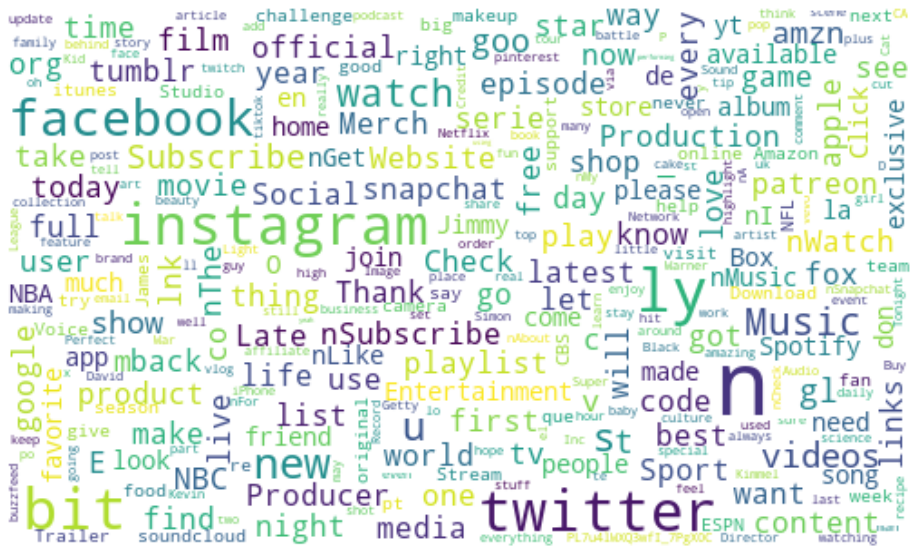

In [ ]:
#  U.S : Most common words in videos descriptions 

des_us = youtube_us['description']

stop=["channel","https","http","youtube","www",'nhttp','link','nhttps','video','nInstagram','url','id','youtu','IQid','smarturl','Follow','nFollow','nFacebook','nTwitter']
stopwords= set(STOPWORDS)
stopwords.update(stop)

wordcloud = WordCloud(width=500, height=300, collocations= False, stopwords=stopwords,max_font_size=50, max_words=300, background_color="white").generate(' '.join(str(t) for t in des_us))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

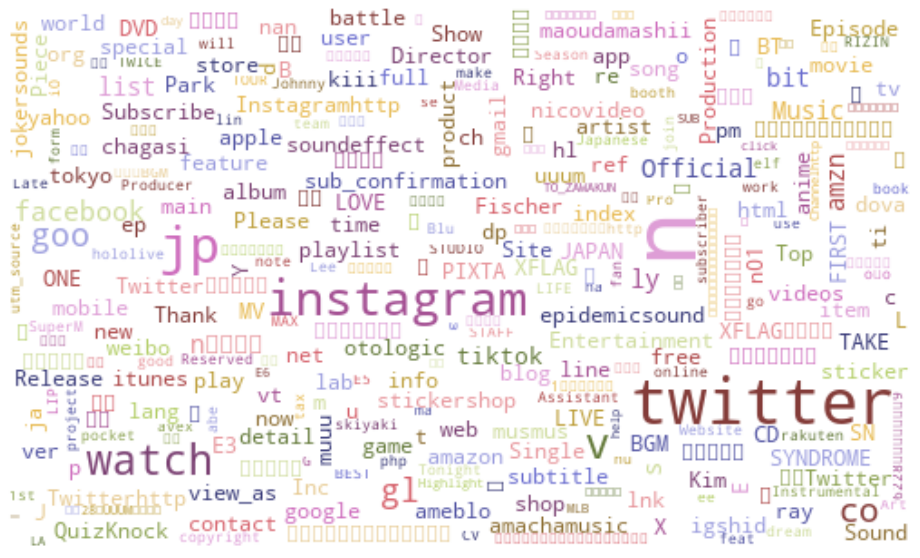

In [ ]:
#  Japan : Most common words in videos descriptions 
des_jp = youtube_jp['description']

stop=["channel","https","http","youtube","www",'nhttp','link','nhttps','video','nInstagram','url','id','youtu','IQid','smarturl','Follow','nFollow','nFacebook','nTwitter']
stopwords= set(STOPWORDS)
stopwords.update(stop)

wordcloud = WordCloud( width=500, height=300, collocations= False, colormap= 'tab20b', stopwords=stopwords,max_font_size=50, max_words=300, background_color="white").generate(' '.join(str(t) for t in des_jp))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

Observation :

The common words in video titles and descriptions show the cultural similaries and differences between Japan users and U.S users. For examples, both Japan and U.S views are attracted to music and gaming videos.  The common words in videos descriptions reflect the popular social media platforms in the two countries. Although both U use Twitter, Instagram, the U.S channel onwens mentioned Tumblr frequently while the Japanes channel owners brougt up TikTok more frequently. 

##3. YouTube Categories Analysis

> Youtube videos are already groupped into several categories, such as musics, entertainment, etc. In this part, we will use the Youtube data in 2018 and 2020 to analyze:

*   Basic statistics (views, videos, likes, dislikes, and trending time
*   Similarities and difference between two years
*   Similarities and difference between two countries

### Top 10 categories for the US and Japan

> Categories reflects watching preference. By extracting top 10 categories, we could find which types of videos viewers prefer to watch.

> We will start from selecting top categories in 2018.

In [6]:
dataforcat=df.copy()
dataforcat2=dataforcat[['trending_date','Country', 'Category_name', 'title', 'view_count', 'likes', 'dislikes', 'comment_count']]
dataforcat2['year']= pd.DatetimeIndex(dataforcat2['trending_date']).year
pre_data2018=dataforcat2.loc[(dataforcat2["year"] == 2018)]

In [7]:
pre_data2018.head()

,trending_date,Country,Category_name,title,view_count,likes,dislikes,comment_count,year
0,2018-05-12 00:00:00 UTC,Japan,Film & Animation,発表！全ガンダム大投票 第１部＆第２部 ５月５日（土）,10428,93,3,3,2018
1,2018-03-12 00:00:00 UTC,Japan,Gaming,【ゆっくり実況】 PCぶっ壊れたかと思ったホラーゲーム Repeat 【ホラーゲーム】,6560,99,13,48,2018
2,2018-04-17 00:00:00 UTC,Japan,Pets & Animals,シャンシャン 飼育員さんとおにごっこ♪,15395,180,14,13,2018
3,2018-04-27 00:00:00 UTC,Japan,Pets & Animals,【特集】シャンシャン大好きな飼育員さん,23964,238,8,7,2018
4,2018-05-11 00:00:00 UTC,Japan,Pets & Animals,飼育員さんにもママにも抱っこされるシャンシャン♪,13687,149,6,7,2018


In [8]:
data20186=pre_data2018.loc[(pre_data2018["Country"] == "Japan")]
top_jp_2018=data20186[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').sum().sort_values(by='view_count', ascending=False)[0:10].reset_index(level='Category_name')
top_jp_2018['Country']='Japan'
top_jp_2018['Year']=2018
top_jp_2018

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Entertainment,1239934955,28506866,1731829,4293273,Japan,2018
1,Music,764106790,60471189,1400528,7557257,Japan,2018
2,Sports,429379576,4428888,273092,777593,Japan,2018
3,People & Blogs,388125741,6430168,569154,1082565,Japan,2018
4,Film & Animation,233820977,4785430,234344,663309,Japan,2018
5,Comedy,193124730,5556164,295152,856064,Japan,2018
6,News & Politics,132478626,1257588,200793,430908,Japan,2018
7,Gaming,118686921,2126294,156000,426307,Japan,2018
8,Science & Technology,109734995,2145307,96793,371707,Japan,2018
9,Howto & Style,73689466,1736685,103439,252250,Japan,2018


Building on top of 10 categories, we will analyze its average view count, likes, dislikes, and comments.

Japan's average views, likes, dislikes, comment counts per video in 2018:

In [9]:
jp18data6me=pre_data2018.loc[(pre_data2018["Country"] == "Japan")]
jp18data7me=jp18data6me.set_index('Category_name')
jp18data8me=jp18data7me.loc[['Entertainment', 'Music', 'Sports', 'People & Blogs', 'Film & Animation', 'Comedy'
,'News & Politics', 'Gaming', 'Science & Technology', 'Howto & Style']].reset_index()

me_jp_2018=jp18data8me[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').mean().sort_values(by='view_count', ascending=False).reset_index(level='Category_name')
me_jp_2018['Country']='Japan'
me_jp_2018['Year']=2018
me_jp_2018

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Science & Technology,997590.863636,19502.790909,879.936364,3379.154545,Japan,2018
1,Music,794289.802495,62859.863825,1455.850312,7855.776507,Japan,2018
2,Comedy,385478.502994,11090.147705,589.125749,1708.710579,Japan,2018
3,Sports,281745.128609,2906.094488,179.194226,510.231627,Japan,2018
4,Entertainment,278386.833184,6400.284239,388.825550,963.914010,Japan,2018
5,Film & Animation,269689.708189,5519.527105,270.292964,765.062284,Japan,2018
6,Gaming,164614.314840,2949.090153,216.366158,591.271845,Japan,2018
7,People & Blogs,137098.460261,2271.341575,201.043448,382.396680,Japan,2018
8,News & Politics,128620.025243,1220.959223,194.944660,418.357282,Japan,2018
9,Howto & Style,127711.379549,3009.852686,179.270364,437.175043,Japan,2018


Let's do the same thing in the US, as well as Japan and US in 2020.

Top 10 categories in 2018 in the US.

In [10]:
data20184=pre_data2018.loc[(pre_data2018["Country"] == "United States")]
top_us_2018=data20184[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').sum().sort_values(by='view_count', ascending=False)[0:10].reset_index(level='Category_name')
top_us_2018['Country']='United States'
top_us_2018['Year']=2018
top_us_2018

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Music,35620222880,1215834918,43593318,107215678,United States,2018
1,Entertainment,16508467368,403997016,28343898,53710101,United States,2018
2,Film & Animation,6397955303,148031680,5270385,15889044,United States,2018
3,People & Blogs,4206833630,158288747,7933796,21115577,United States,2018
4,Sports,4021607276,90123029,4871409,10301014,United States,2018
5,Comedy,3979711002,159350177,5526728,17319765,United States,2018
6,Howto & Style,3272024446,134900254,4362090,18164949,United States,2018
7,Science & Technology,2972489648,67850749,3644629,9817596,United States,2018
8,Gaming,2077174542,67101781,9111103,14515284,United States,2018
9,News & Politics,1236917949,14760139,2796362,4763139,United States,2018


US average views, likes, dislikes, comment counts per video in 2018:

In [11]:
us18data6me=pre_data2018.loc[(pre_data2018["Country"] == "United States")]
us18data7me=us18data6me.set_index('Category_name')
us18data8me=us18data7me.loc[['Music', 'Entertainment', 'Film & Animation', 'People & Blogs', 'Sports', 'Comedy'
,'News & Politics', 'Gaming', 'Science & Technology', 'Howto & Style']].reset_index()

me_us_2018=us18data8me[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').mean().sort_values(by='view_count', ascending=False).reset_index(level='Category_name')
me_us_2018['Country']='United States'
me_us_2018['Year']=2018
me_us_2018

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Music,7.451929e+06,254358.769456,9119.941004,22430.058159,United States,2018
1,Film & Animation,3.704664e+06,85716.085698,3051.757383,9200.372901,United States,2018
2,Gaming,2.857186e+06,92299.561210,12532.466300,19966.002751,United States,2018
3,Sports,2.444746e+06,54786.035866,2961.342857,6262.014590,United States,2018
4,Entertainment,2.234800e+06,54690.268851,3836.997157,7270.894951,United States,2018
5,People & Blogs,1.808613e+06,68051.911866,3410.918315,9078.064058,United States,2018
6,Science & Technology,1.658755e+06,37863.141183,2033.833147,5478.569196,United States,2018
7,Comedy,1.622385e+06,64961.344068,2253.048512,7060.646148,United States,2018
8,Howto & Style,1.035779e+06,42703.467553,1380.845204,5750.221273,United States,2018
9,News & Politics,7.349483e+05,8770.136067,1661.534165,2830.147950,United States,2018


Top 10 categories in 2020 in the Japan.

In [12]:
pre_data=dataforcat2.loc[(dataforcat2["year"] == 2020)]

In [13]:
pre_data.head()

,trending_date,Country,Category_name,title,view_count,likes,dislikes,comment_count,year
10,2020-08-30 00:00:00 UTC,Japan,Music,Tak Matsumoto “Bluesman” YouTube Live,288320,12343,60,212,2020
11,2020-09-02 00:00:00 UTC,Japan,Music,Tak Matsumoto “Bluesman” YouTube Live,363584,13159,72,256,2020
12,2020-08-31 00:00:00 UTC,Japan,Music,Tak Matsumoto “Bluesman” YouTube Live,324387,12777,64,230,2020
13,2020-09-03 00:00:00 UTC,Japan,Music,Tak Matsumoto “Bluesman” YouTube Live,375254,13249,75,254,2020
14,2020-09-04 00:00:00 UTC,Japan,Music,Tak Matsumoto “Bluesman” YouTube Live,382518,13304,79,257,2020


In [14]:
data6=pre_data.loc[(pre_data["Country"] == "Japan")]
top_jp_2020=data6[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').sum().sort_values(by='view_count', ascending=False)[0:10].reset_index(level='Category_name')
top_jp_2020['Country']='Japan'
top_jp_2020['Year']=2020
top_jp_2020

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Music,10390685184,830284812,22911272,138510031,Japan,2020
1,Entertainment,4011742465,137782185,5155051,14804255,Japan,2020
2,People & Blogs,1098249709,33532873,1072044,2730189,Japan,2020
3,Comedy,1072481774,62957859,821108,3785890,Japan,2020
4,Gaming,864214032,24601826,695949,2354516,Japan,2020
5,Science & Technology,551903730,14461024,941125,106679,Japan,2020
6,Film & Animation,500705920,10154969,169475,1021092,Japan,2020
7,Sports,431221051,5367931,217964,1032257,Japan,2020
8,Howto & Style,356542189,9010844,364865,883571,Japan,2020
9,Autos & Vehicles,225314581,13239850,154176,616750,Japan,2020


Japan average views, likes, dislikes, comment counts per video in 2020:

In [15]:
jp20data6me=pre_data.loc[(pre_data["Country"] == "Japan")]
jp20data7me=jp20data6me.set_index('Category_name')
jp20data8me=jp20data7me.loc[['Music','Entertainment', 'People & Blogs', 'Comedy', 'Gaming', 'Science & Technology'
,'Film & Animation', 'Sports', 'Howto & Style', 'Autos & Vehicles']].reset_index()

me_jp_2020=jp20data8me[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').mean().sort_values(by='view_count', ascending=False).reset_index(level='Category_name')
me_jp_2020['Country']='Japan'
me_jp_2020['Year']=2020
me_jp_2020

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Science & Technology,7.665330e+06,200847.555556,13071.180556,1481.652778,Japan,2020
1,Music,5.775812e+06,461525.743191,12735.559755,76992.790995,Japan,2020
2,Comedy,1.319166e+06,77438.940959,1009.972940,4656.691267,Japan,2020
3,Gaming,1.163141e+06,33111.475101,936.674293,3168.931359,Japan,2020
4,Entertainment,8.044400e+05,27628.270503,1033.697814,2968.569280,Japan,2020
5,Autos & Vehicles,6.024454e+05,35400.668449,412.235294,1649.064171,Japan,2020
6,Film & Animation,5.651308e+05,11461.590293,191.281038,1152.474041,Japan,2020
7,People & Blogs,5.527175e+05,16876.131354,539.528938,1374.025667,Japan,2020
8,Howto & Style,4.805151e+05,12143.994609,491.731806,1190.796496,Japan,2020
9,Sports,4.791345e+05,5964.367778,242.182222,1146.952222,Japan,2020


Top 10 categories in 2020 in the US.

In [16]:
data4=pre_data.loc[(pre_data["Country"] == "United States")]
top_us_2020=data4[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').sum().sort_values(by='view_count', ascending=False)[0:10].reset_index(level='Category_name')
top_us_2020['Country']='United States'
top_us_2020['Year']=2020
top_us_2020

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Music,15184206655,1108613505,31615188,168745414,United States,2020
1,Entertainment,5997855145,384206651,7715464,31972762,United States,2020
2,Gaming,3398117165,168307253,4638537,16371494,United States,2020
3,Sports,2357745162,53348919,1867254,6328972,United States,2020
4,People & Blogs,2326373242,152216157,4737424,10952876,United States,2020
5,Science & Technology,1141368550,44403004,1423475,3649090,United States,2020
6,Comedy,1111570479,98953571,1135647,6903884,United States,2020
7,Film & Animation,906753925,47011743,982133,3664046,United States,2020
8,Howto & Style,687549514,43021861,1273706,3346152,United States,2020
9,News & Politics,553992951,8467804,1335936,3737017,United States,2020


US average views, likes, dislikes, comment counts per video in 2020:

In [17]:
us20data6me=pre_data.loc[(pre_data["Country"] == "United States")]
us20data7me=us20data6me.set_index('Category_name')
us20data8me=us20data7me.loc[['Music','Entertainment', 'Gaming', 'Sports', 'People & Blogs', 'Science & Technology'
,'Film & Animation', 'Comedy', 'Howto & Style', 'News & Politics']].reset_index()

me_us_2020=us20data8me[['Category_name', 'view_count', 'likes', 'dislikes', 'comment_count']].groupby('Category_name').mean().sort_values(by='view_count', ascending=False).reset_index(level='Category_name')
me_us_2020['Country']='United States'
me_us_2020['Year']=2020
me_us_2020

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Music,5.212567e+06,380574.495366,10853.136972,57928.394782,United States,2020
1,Gaming,2.996576e+06,148419.094356,4090.420635,14436.943563,United States,2020
2,Entertainment,2.533948e+06,162317.976764,3259.596113,13507.715251,United States,2020
3,People & Blogs,2.103412e+06,137627.628391,4283.385172,9903.142857,United States,2020
4,Science & Technology,1.988447e+06,77357.149826,2479.921603,6357.299652,United States,2020
5,Film & Animation,1.806283e+06,93648.890438,1956.440239,7298.896414,United States,2020
6,Sports,1.520145e+06,34396.466151,1203.903288,4080.575113,United States,2020
7,Comedy,1.387728e+06,123537.541823,1417.786517,8619.081149,United States,2020
8,Howto & Style,1.199912e+06,75081.781850,2222.872600,5839.706806,United States,2020
9,News & Politics,9.963902e+05,15229.863309,2402.762590,6721.253597,United States,2020


Combine the top 10 catogories charts:

In [18]:
merged_data_2=top_jp_2020.append(top_us_2020).append(top_jp_2018).append(top_us_2018)

In [19]:
merged_data_2.head()

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Music,10390685184,830284812,22911272,138510031,Japan,2020
1,Entertainment,4011742465,137782185,5155051,14804255,Japan,2020
2,People & Blogs,1098249709,33532873,1072044,2730189,Japan,2020
3,Comedy,1072481774,62957859,821108,3785890,Japan,2020
4,Gaming,864214032,24601826,695949,2354516,Japan,2020


Combine the average of view count, likes, dislikes, and comment count:

In [20]:
me_merged_data_2=me_jp_2020.append(me_us_2020).append(me_jp_2018).append(me_us_2018)
me_merged_data_2.head()

,Category_name,view_count,likes,dislikes,comment_count,Country,Year
0,Science & Technology,7.665330e+06,200847.555556,13071.180556,1481.652778,Japan,2020
1,Music,5.775812e+06,461525.743191,12735.559755,76992.790995,Japan,2020
2,Comedy,1.319166e+06,77438.940959,1009.972940,4656.691267,Japan,2020
3,Gaming,1.163141e+06,33111.475101,936.674293,3168.931359,Japan,2020
4,Entertainment,8.044400e+05,27628.270503,1033.697814,2968.569280,Japan,2020


Let's create some bar plot with selected data!

Top 10 Categories:

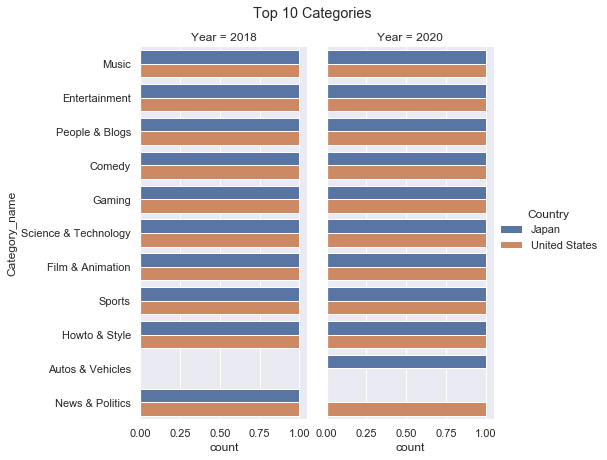

In [21]:
sns.catplot(y="Category_name", kind="count", hue='Country', col='Year', data=merged_data_2, height=6, aspect=0.6);
plt.suptitle('Top 10 Categories', x=0.53, y=1.03)
plt.savefig('Top 10 Categories.jpg', bbox_inches='tight')
plt.show()

US and Japan share all categories in 2018 and share most of the categories in 2020.

After taking a glance of shared categories, let's take a look at average views, likes, and dislikes!

Average View Counts per Video by Categories:

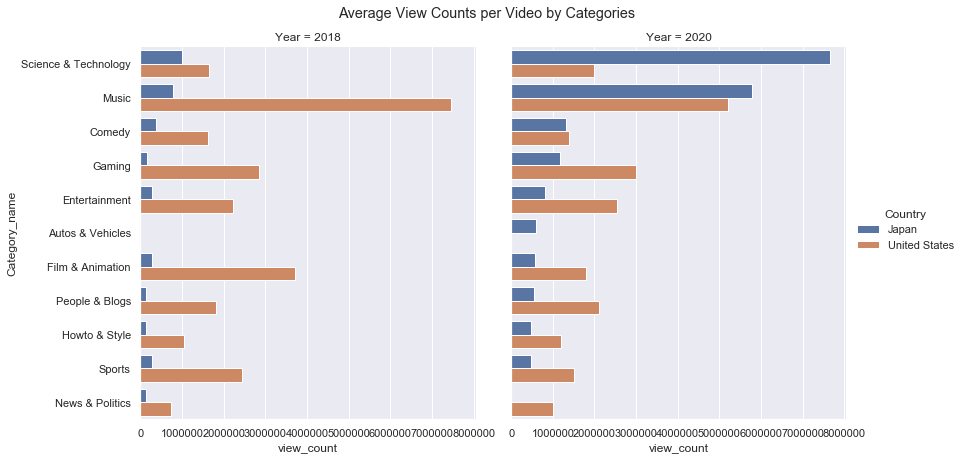

In [22]:
sns.catplot(x="view_count", y="Category_name", hue="Country", col='Year', kind="bar", data=me_merged_data_2, height=6, aspect=1)
plt.suptitle('Average View Counts per Video by Categories', x=0.51, y=1.03)
plt.savefig('Average View Counts per Video by Categories.jpg', bbox_inches='tight')
plt.show()

Average Likes per Video by Categories:

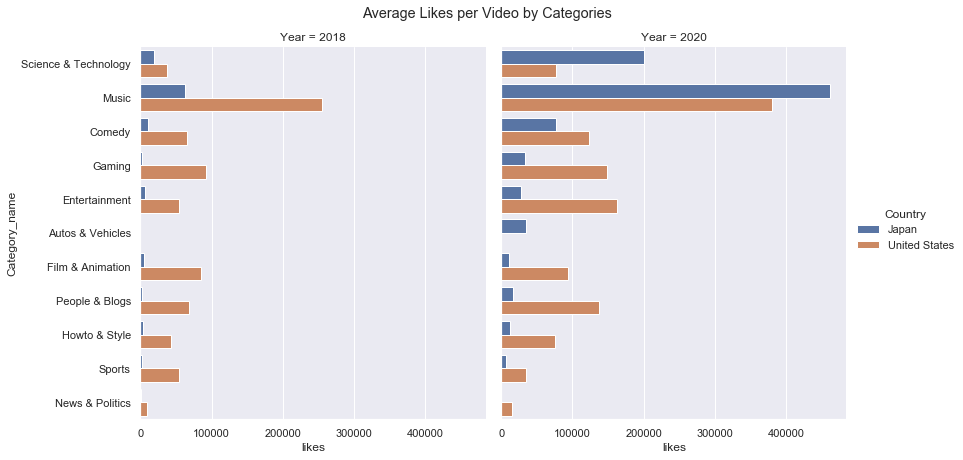

In [23]:
sns.catplot(x="likes", y="Category_name", hue="Country", kind="bar", col='Year', data=me_merged_data_2, height=6, aspect=1)
plt.suptitle('Average Likes per Video by Categories', x=0.51, y=1.03);
plt.savefig('Average Likes per Video by Categories.jpg', bbox_inches='tight')

Average Dislikes per Video by Categories:

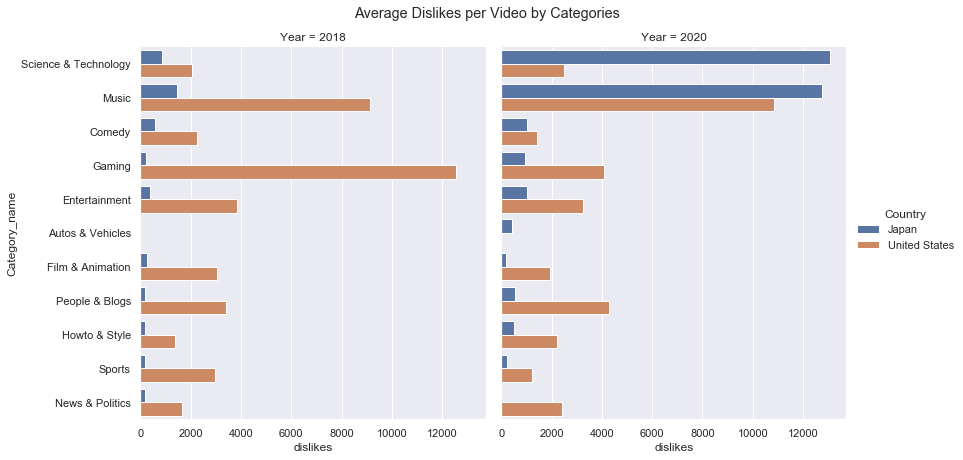

In [24]:
view_count_plot=sns.catplot(x="dislikes", y="Category_name", hue="Country", kind="bar", col='Year', data=me_merged_data_2, height=6, aspect=1);
plt.suptitle('Average Dislikes per Video by Categories', x=0.51, y=1.03);
plt.savefig('Average Dislikes per Video by Categories.jpg', bbox_inches='tight')

Average Comment Counts per Video by Categories:

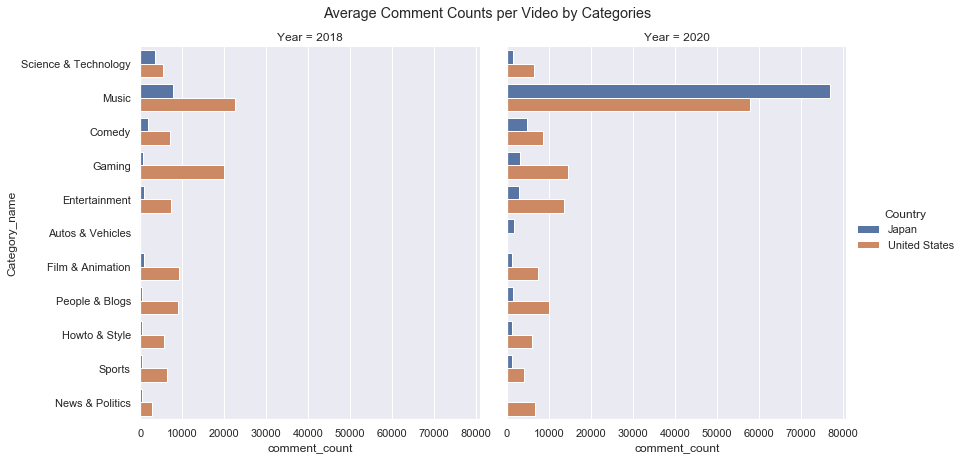

In [25]:
sns.catplot(x="comment_count", y="Category_name", hue="Country", col='Year', kind="bar", data=me_merged_data_2, height=6, aspect=1)
plt.suptitle('Average Comment Counts per Video by Categories', x=0.51, y=1.03);
plt.savefig('Average Comment Counts per Video by Categories.jpg', bbox_inches='tight')

Obvious, music as well as Science & Technology top the list of categories. In 2020, views, likes, and dislikes significantly increased.

Compare music to Science & Technology. Though both have losts of view counts, likes, and dislikes in 2020, there are only a few comments in Science & Technology categories but many comments in music categories.

What about the trending time? Or in other words, how long does one category become popular? Does music as well as Sience & Technology categories catch major viewers' attention in a short amount of time? Let's take a look!



We will use the original data for analysis

In [26]:
cat_go_trend=df.copy()
cat_go_trend.head(1)

,video_id,title,publishedAt,channelId,channelTitle,categoryId,trending_date,view_count,likes,dislikes,...,comments_disabled,ratings_disabled,description,Category_name,Country,publish_year,publish_time,publish_datetime,trending_datetime,days_to_go_trending
0,T7Ux7BbkPDw,発表！全ガンダム大投票 第１部＆第２部 ５月５日（土）,2018-05-06 18:18:16 UTC,,a,1,2018-05-12 00:00:00 UTC,10428,93,3,...,False,False,,Film & Animation,Japan,2018,18:18:16,2018-05-06 18:18:16+00:00,2018-05-12 00:00:00+00:00,5 days 05:41:44


Calculate each video's trending date.

In [27]:
cat_go_trend['publish_year'] = pd.DatetimeIndex(cat_go_trend['publishedAt']).year
cat_go_trend['publish_time'] = pd.to_datetime(cat_go_trend['publishedAt']).dt.time
cat_go_trend['publish_datetime'] = pd.to_datetime(cat_go_trend['publishedAt'])
cat_go_trend['trending_datetime'] = pd.to_datetime(cat_go_trend['trending_date'])
cat_go_trend['days_to_go_trending'] = cat_go_trend['trending_datetime'] - cat_go_trend['publish_datetime']
cat_go_trend['days_to_go_trending'] = cat_go_trend['trending_datetime'] - cat_go_trend['publish_datetime']
cat_go_trend['total_seconds_to_go_trending'] = cat_go_trend['days_to_go_trending'].dt.total_seconds().astype(int)
cat_go_trend['days_to_go_trending']= cat_go_trend['total_seconds_to_go_trending']/86400
cat_go_trend['year']= pd.DatetimeIndex(cat_go_trend['trending_date']).year
cat_go_trend_2= cat_go_trend[['Country','Category_name','title','year','days_to_go_trending']]
cat_go_trend_2.head()

,Country,Category_name,title,year,days_to_go_trending
0,Japan,Film & Animation,発表！全ガンダム大投票 第１部＆第２部 ５月５日（土）,2018,5.237315
1,Japan,Gaming,【ゆっくり実況】 PCぶっ壊れたかと思ったホラーゲーム Repeat 【ホラーゲーム】,2018,0.375752
2,Japan,Pets & Animals,シャンシャン 飼育員さんとおにごっこ♪,2018,0.666644
3,Japan,Pets & Animals,【特集】シャンシャン大好きな飼育員さん,2018,1.041620
4,Japan,Pets & Animals,飼育員さんにもママにも抱っこされるシャンシャン♪,2018,0.666667


Group all the videos into different categories. Calculate average days to go trending for each category.

In [28]:
cat_go_trend_2_2018=cat_go_trend_2.copy()
cat_go_trend_jp_2018=cat_go_trend_2_2018.loc[(cat_go_trend_2_2018["year"] == 2018)].loc[(cat_go_trend_2_2018["Country"] == "Japan")]

top_trend_jp_2018=cat_go_trend_jp_2018.groupby('Category_name').mean().sort_values(by='days_to_go_trending', ascending=True).reset_index(level='Category_name')
top_trend_jp_2018['Country']='Japan'
top_trend_jp_2018['Year']=2018

cat_go_trend_us_2018=cat_go_trend_2_2018.loc[(cat_go_trend_2["year"] == 2018)].loc[(cat_go_trend_2_2018["Country"] == "United States")]

top_trend_us_2018=cat_go_trend_us_2018.groupby('Category_name').mean().sort_values(by='days_to_go_trending', ascending=True).reset_index(level='Category_name')
top_trend_us_2018['Country']='United States'
top_trend_us_2018['Year']=2018

cat_go_trend_jp=cat_go_trend_2.loc[(cat_go_trend_2["year"] == 2020)].loc[(cat_go_trend_2["Country"] == "Japan")]

top_trend_jp=cat_go_trend_jp.groupby('Category_name').mean().sort_values(by='days_to_go_trending', ascending=True).reset_index(level='Category_name')
top_trend_jp['Country']='Japan'
top_trend_jp['Year']=2020

cat_go_trend_us=cat_go_trend_2.loc[(cat_go_trend_2["year"] == 2020)].loc[(cat_go_trend_2["Country"] == "United States")]

top_trend_us=cat_go_trend_us.groupby('Category_name').mean().sort_values(by='days_to_go_trending', ascending=True).reset_index(level='Category_name')
top_trend_us['Country']='United States'
top_trend_us['Year']=2020

trending_time_data=top_trend_jp_2018.append(top_trend_us_2018).append(top_trend_jp).append(top_trend_us)
trending_time_data.head()



,Category_name,year,days_to_go_trending,Country,Year
0,Education,2018,0.527337,Japan,2018
1,Sports,2018,0.599462,Japan,2018
2,Pets & Animals,2018,0.607191,Japan,2018
3,News & Politics,2018,0.661853,Japan,2018
4,Travel & Events,2018,0.727762,Japan,2018


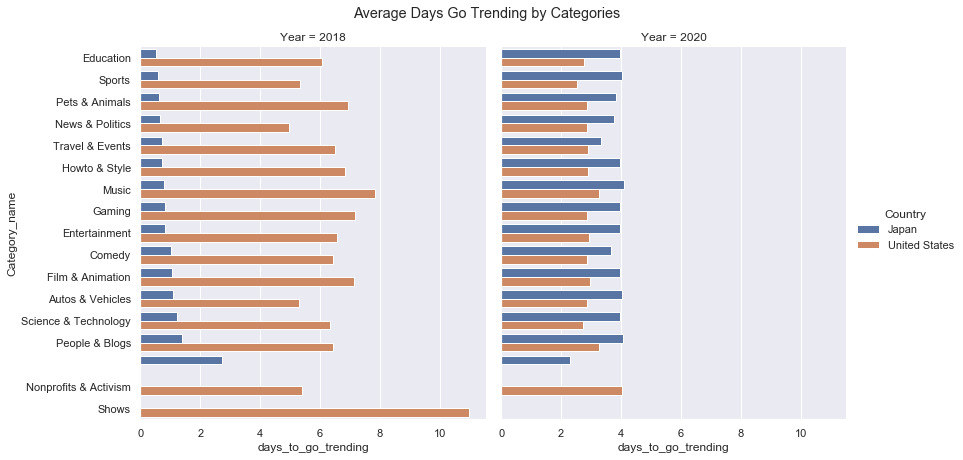

In [29]:
sns.catplot(x="days_to_go_trending", y="Category_name", hue="Country", col= 'Year', kind="bar", data=trending_time_data, height=6, aspect=1)
plt.suptitle('Average Days Go Trending by Categories', x=0.51, y=1.03);
plt.savefig('Average Days Go Trending by Categories.jpg', bbox_inches='tight')

We could gain several conclusions from the visualization:

* Videos from Music and Science & Technology categories, which are the group wins the top 2 view counts, does not have shorter trending time. Thus, trending time and view counts are not correlated.

* Over 2 years, trending time in Japan has significantly increased, while trending time in the US has significantly decreased.

## 5. YouTube Videos Analysis

> After analyzing Youtube videos in a "macro" aspect, we could start focusing on the "micro" side. For this section, we will grab videos with top 10 view counts, analyze its statistics, and monitor how long does a video take to go trending.


### Top 10 videos  in 2020 for US and Japan

> To create an ideal data for visualization, create a dataset of top 10 videos from each country.

Top 10 Videos in Japan:

In [30]:
data_a=pre_data.loc[(pre_data["Country"] == "Japan")]
top_jp_videos=data_a.groupby('title').sum().sort_values(by='view_count', ascending=False)[0:10].reset_index('title')
top_jp_videos['Country']='Japan'
top_jp_videos

,title,view_count,likes,dislikes,comment_count,year,Country
0,BTS (방탄소년단) 'Dynamite' Official MV,1948824175,140509764,5912301,54785147,20200,Japan
1,BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V,1181849189,85887782,6334334,21343121,16160,Japan
2,BLACKPINK – ‘Lovesick Girls’ M/V,1122571356,82574378,945688,13941329,20200,Japan
3,BTS (방탄소년단) 'Dynamite' Official Teaser,442479528,46262660,1119539,7799293,16160,Japan
4,BTS (방탄소년단) 'Dynamite' Official MV (B-side),358847120,50797734,796088,3354702,18180,Japan
5,NCT U 엔시티 유 'Make A Wish (Birthday Song)' MV,314483880,10850498,154059,2717800,12120,Japan
6,Cardi B - WAP feat. Megan Thee Stallion [Offic...,247810667,8785584,1223284,846936,6060,Japan
7,Justin Bieber - Holy ft. Chance The Rapper,239077043,16852222,390967,1309695,16160,Japan
8,Stray Kids Back Door M/V,234212016,13919811,154702,4586326,14140,Japan
9,Apple Event — October 13,231516781,4390105,224006,0,10100,Japan


Top 10 Videos in the US:

In [31]:
data_b=pre_data.loc[(pre_data["Country"] == "United States")]
top_us_videos=data_b.groupby('title').sum().sort_values(by='view_count', ascending=False)[0:10].reset_index('title')
top_us_videos['Country']='United States'
top_us_videos

,title,view_count,likes,dislikes,comment_count,year,Country
0,BTS (방탄소년단) 'Dynamite' Official MV,1388564083,107183079,4268039,41666309,16160,United States
1,BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V,1233082942,91799816,6739558,23191061,18180,United States
2,Justin Bieber - Holy ft. Chance The Rapper,1014588187,58974801,1448496,4418737,50500,United States
3,BLACKPINK – ‘Lovesick Girls’ M/V,823163248,63844212,671622,10895923,16160,United States
4,Cardi B - WAP feat. Megan Thee Stallion [Offic...,440186929,15125175,2143806,1461029,10100,United States
5,BTS (방탄소년단) 'Dynamite' Official Teaser,320085636,33971814,808540,5792813,12120,United States
6,DJ Khaled ft. Drake - POPSTAR (Official Music ...,286327150,16081380,737484,945831,20200,United States
7,Drake - Laugh Now Cry Later (Official Music Vi...,271592962,12528423,304292,800109,20200,United States
8,"AMONG US, but with 99 IMPOSTORS",259385449,9795700,203030,298288,12120,United States
9,BTS (방탄소년단) 'Dynamite' Official MV (B-side),226652642,33136176,511324,2218674,12120,United States


Next, combine two dataset into one to make data ready for visualization.

In [32]:
top_videos_data=top_jp_videos.append(top_us_videos)
top_videos_data

,title,view_count,likes,dislikes,comment_count,year,Country
0,BTS (방탄소년단) 'Dynamite' Official MV,1948824175,140509764,5912301,54785147,20200,Japan
1,BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V,1181849189,85887782,6334334,21343121,16160,Japan
2,BLACKPINK – ‘Lovesick Girls’ M/V,1122571356,82574378,945688,13941329,20200,Japan
3,BTS (방탄소년단) 'Dynamite' Official Teaser,442479528,46262660,1119539,7799293,16160,Japan
4,BTS (방탄소년단) 'Dynamite' Official MV (B-side),358847120,50797734,796088,3354702,18180,Japan
5,NCT U 엔시티 유 'Make A Wish (Birthday Song)' MV,314483880,10850498,154059,2717800,12120,Japan
6,Cardi B - WAP feat. Megan Thee Stallion [Offic...,247810667,8785584,1223284,846936,6060,Japan
7,Justin Bieber - Holy ft. Chance The Rapper,239077043,16852222,390967,1309695,16160,Japan
8,Stray Kids Back Door M/V,234212016,13919811,154702,4586326,14140,Japan
9,Apple Event — October 13,231516781,4390105,224006,0,10100,Japan


It's time to start our analysis!

It is a bit surprising that top lists of videos from both countries are similar.Especially, Korean videos, like BTS and BlackPink, received high view_counts, likes, and dislikes from both countries.

Total View Counts by Video:

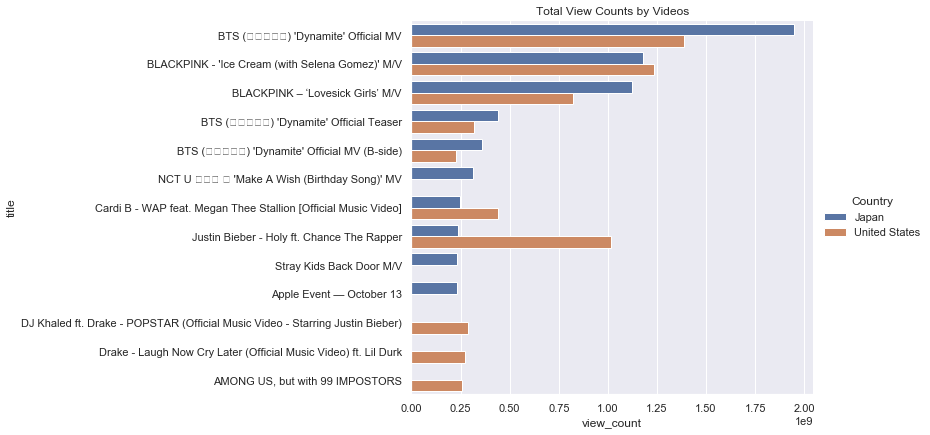

In [33]:
sns.catplot(x="view_count", y="title", hue="Country", kind="bar", data=top_videos_data, height=6, aspect=2)
plt.title('Total View Counts by Videos');

Total Likes by Videos:

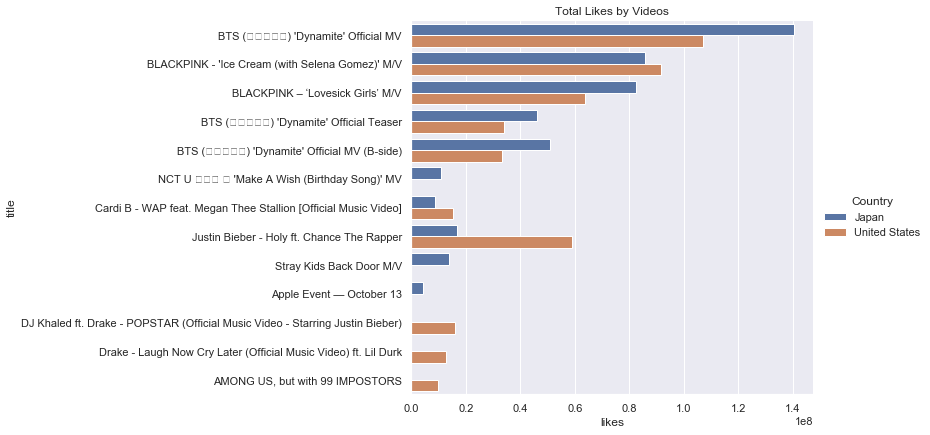

In [34]:
sns.catplot(x="likes", y="title", hue="Country", kind="bar", data=top_videos_data, height=6, aspect=2)
plt.title('Total Likes by Videos');

Total Dislikes by Videos:

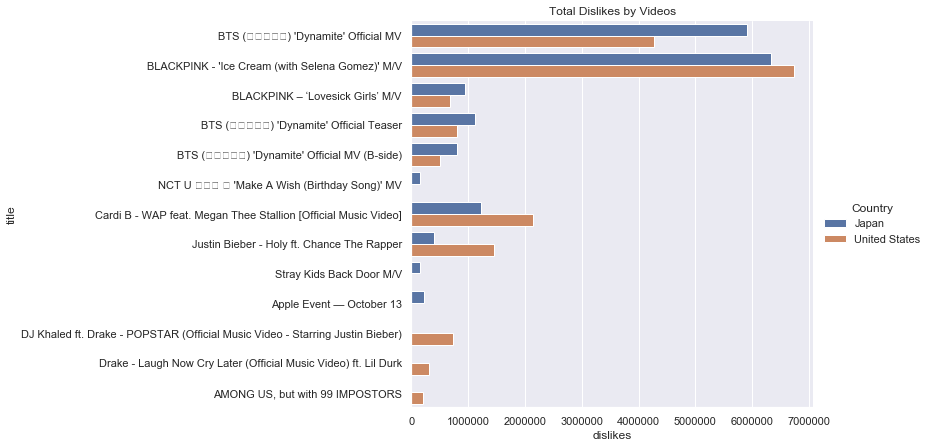

In [35]:
video_view_count_plot=sns.catplot(x="dislikes", y="title", hue="Country", kind="bar", data=top_videos_data, height=6, aspect=2)
plt.title('Total Dislikes by Videos');

It seems that both Japanese and American are the fan of Korea music!

## Correlation between Catogories and Top Videos

### How many both top videos for each category?(To Japan Category and US Category)

In [36]:
youtube_jp = df.copy()
youtube_jp = youtube_jp[youtube_jp['Country']=='Japan']
corr_jp = youtube_jp.groupby(['Category_name','Country','title','video_id'])['view_count'].sum().reset_index()
youtube_us = df.copy()
youtube_us = youtube_us[youtube_us['Country']=='United States']
corr_us = youtube_us.groupby(['Category_name','Country','title','video_id'])['view_count'].sum().reset_index()
merged = corr_us.merge(corr_jp, how='inner', on=['video_id','title'], suffixes=('_us','_jp'))
merged.groupby('Category_name_us').agg({'video_id':'count'}).sort_values(by='video_id', ascending=False)

,video_id
Category_name_us,
Music,94
Entertainment,35
Film & Animation,19
Gaming,18
Science & Technology,15
People & Blogs,14
Sports,14
Comedy,9
Howto & Style,4


Text(0.5, 1.0, 'Correlation between Categories and Top Videos')

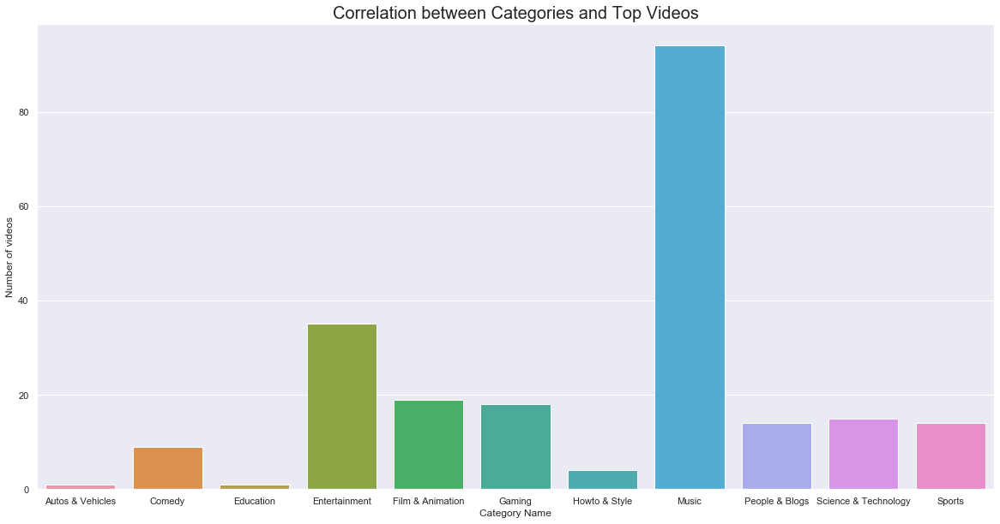

In [37]:
g = sns.countplot(x='Category_name_us',data=merged)
g.set(xlabel='Category Name',ylabel='Number of videos')
g.set_title('Correlation between Categories and Top Videos',size=20)

# Trending Videos

In this part, we want to analyze the time that videos took to go trending.

### Top Trending videos in United States

In [38]:
youtube_1 = df[(df['publish_year']==2018)&(df['Country']=='United States')]
youtube_videos = youtube_1.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
us = youtube_videos[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=False)
b = us['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
a = us.drop(columns=['days_to_go_trending'])
us_days_to_go_trending2018 = pd.concat([a,b],axis=1).head(9)
us_days_to_go_trending2018 = us_days_to_go_trending2018.replace({'days_to_go_trending':-1},0)
us_days_to_go_trending2018.head()


,title,video_id,Country,view_count,Category_name,days_to_go_trending
3342,"Benedict Cumberbatch, Tom Hiddleston and Tom H...",jYuQzAxBVZU,United States,1270251,Entertainment,35
29764,clickbait,f4FuOi9rvKw,United States,1800130,Film & Animation,35
21480,SNL’s Kate McKinnon and Beth Kobliner talk mon...,ZP57Kn9eAAQ,United States,342564,Education,35
17766,Mirror-Polished Japanese Foil Ball Challenge C...,oJ2faqXlU1s,United States,18726265,Entertainment,34
21479,SNL’s Kate McKinnon and Beth Kobliner talk mon...,ZP57Kn9eAAQ,United States,290631,Education,34


In [ ]:
youtube_1 = df[(df['publish_year']==2020)&(df['Country']=='United States')]
youtube_videos = youtube_1.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
us = youtube_videos[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=False)
b = us['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
a = us.drop(columns=['days_to_go_trending'])
us_days_to_go_trending2020 = pd.concat([a,b],axis=1).head(20)
us_days_to_go_trending2020 = us_days_to_go_trending2020.replace({'days_to_go_trending':-1},0)
us_days_to_go_trending2020.head()

,title,video_id,Country,view_count,Category_name,days_to_go_trending
11518,Walmart Back to College | However you study,izVdUXx5zaU,United States,2729793,People & Blogs,30
11517,Walmart Back to College | However you study,izVdUXx5zaU,United States,2607403,People & Blogs,29
508,A different kind of membership. Walmart+ | The...,MeYkO5vkakg,United States,11633558,People & Blogs,28
505,A different kind of membership. Walmart+ | Mob...,TR0I0STLyws,United States,138866,People & Blogs,28
11516,Walmart Back to College | However you study,izVdUXx5zaU,United States,2117181,People & Blogs,28


## The longerst time for videos to go trending in The US

[Text(0, 0, "Benedict Cumberbatch, Tom Hiddleston and Tom Holland dish on 'Avengers: Infinity War'"),
 Text(1, 0, 'clickbait'),
 Text(2, 0, 'SNL’s Kate McKinnon and Beth Kobliner talk money with kids. Fun with financial literacy!'),
 Text(3, 0, "Mirror-Polished Japanese Foil Ball Challenge Crushed in a Hydraulic Press-What's Inside?"),
 Text(4, 0, 'The Weeknd - Call Out My Name (Official Video)')]

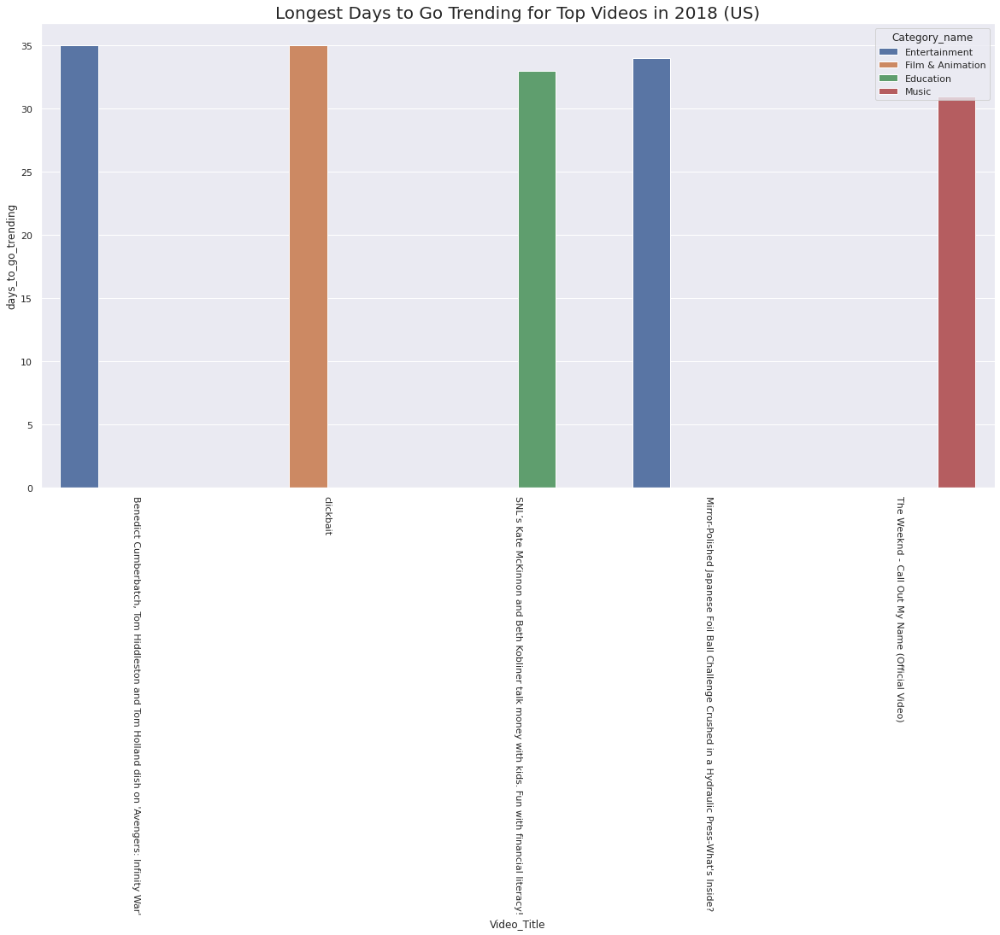

In [ ]:
gv1 = sns.barplot(y='days_to_go_trending',x='title',data=us_days_to_go_trending2018,ci=None,hue='Category_name')
gv1.set(xlabel='Video_Title',ylabel='days_to_go_trending')
gv1.set_title('Longest Days to Go Trending for Top Videos in 2018 (US)',size=20)
gv1.set_xticklabels(gv1.get_xticklabels(), rotation=-90)

[Text(0, 0, 'Walmart Back to College | However you study'),
 Text(1, 0, 'A different kind of membership. Walmart+ | The Cox Family'),
 Text(2, 0, 'A different kind of membership. Walmart+ | Mobile scan & go'),
 Text(3, 0, 'Justin Bieber - Holy ft. Chance The Rapper'),
 Text(4, 0, 'Ay, DiOs Mío!')]

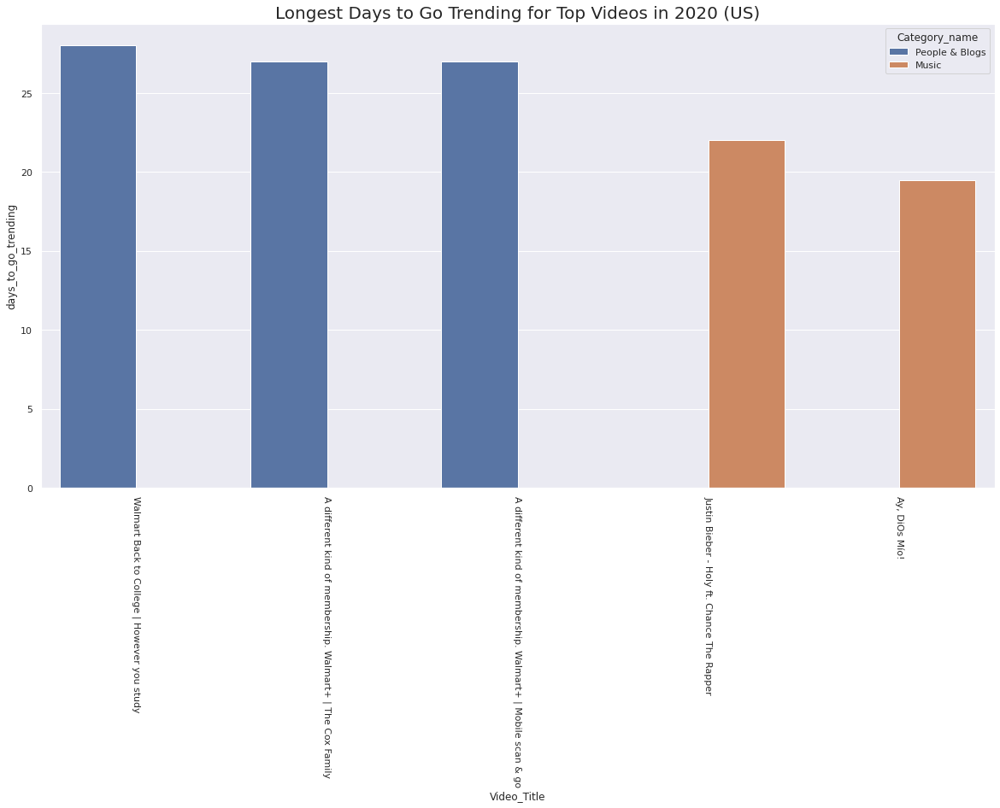

In [ ]:
gv2 = sns.barplot(y='days_to_go_trending',x='title',data=us_days_to_go_trending2020,ci=None,hue='Category_name')
gv2.set(xlabel='Video_Title',ylabel='days_to_go_trending')
gv2.set_title('Longest Days to Go Trending for Top Videos in 2020 (US)',size=20)
gv2.set_xticklabels(gv2.get_xticklabels(), rotation=-90)

In [39]:
youtube_1 = df[(df['publish_year']==2020)&(df['Country']=='United States')]
youtube_videos = youtube_1.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
us = youtube_videos[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=True)
b = us['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
a = us.drop(columns=['days_to_go_trending'])
us_days_to_go_trending = pd.concat([a,b],axis=1)
us_days_to_go_trending_min2020 = us_days_to_go_trending[us_days_to_go_trending['days_to_go_trending']>=0].head(20)
us_days_to_go_trending_min2020 = us_days_to_go_trending_min2020.replace({'days_to_go_trending':-1},0)
us_days_to_go_trending_min2020.head()

,title,video_id,Country,view_count,Category_name,days_to_go_trending
5354,JD Pantoja - Idiota (Official Video),Ad84d7g0UkE,United States,1591043,Music,0
1276,BLACKPINK Reacts To BLACKPINK: LIGHT UP THE SK...,7ez9mg6lOrM,United States,1195279,Entertainment,0
12226,YoungBoy Never Broke Again - Callin (feat. Sno...,7KTt4_M09Rw,United States,1636628,Music,0
3908,Giants vs. Cowboys Week 5 Highlights | NFL 2020,eujFTIUuMYs,United States,1145362,Sports,0
1893,Buccaneers vs. Saints Week 1 Highlights | NFL ...,eUlgPM4IQbU,United States,1276810,Sports,0


In [40]:
youtube_1 = df[(df['publish_year']==2018)&(df['Country']=='United States')]
youtube_videos = youtube_1.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
us = youtube_videos[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=True)
b = us['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
a = us.drop(columns=['days_to_go_trending'])
us_days_to_go_trending = pd.concat([a,b],axis=1)
us_days_to_go_trending_min = us_days_to_go_trending[us_days_to_go_trending['days_to_go_trending']>=0].head(20)
us_days_to_go_trending_min = us_days_to_go_trending_min.replace({'days_to_go_trending':-1},0)
us_days_to_go_trending_min.head()

,title,video_id,Country,view_count,Category_name,days_to_go_trending
16503,MY FACE CHART RECREATION! | MILK1422,5XUwdZkM6N8,United States,49037,Howto & Style,0
27203,WE TRIED TO MAKE TASTY'S GIANT MACARON (VERSUS),zNZJNlx4P80,United States,224124,Entertainment,0
26650,Turkish Airlines - 5 Senses with Dr. Oz,yvicqMrAHvQ,United States,936185,Travel & Events,0
26390,Trader Green Room: All Evening Long,4HSul1NBFes,United States,3831,Education,0
9287,Funniest Local Commercial With Kirk Cousins & ...,4BiWtH0HywY,United States,118344,People & Blogs,0


# How many videos are in each day interval

In [50]:
#2018
youtube_1 = df[(df['publish_year']==2018)&(df['Country']=='United States')]
youtube_videos = youtube_1.groupby(['title','video_id','Country','view_count','days_to_go_trending']).sum().reset_index()
us = youtube_videos[['title','video_id','Country','view_count','days_to_go_trending']].sort_values(by='days_to_go_trending',ascending=False)
b = us['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
a = us.drop(columns=['days_to_go_trending'])
us_days_to_go_trending2018 = pd.concat([a,b],axis=1)
us_days_to_go_trending2018 = us_days_to_go_trending2018.replace({'days_to_go_trending':-1},0)
us_days_to_go_trending2018.head()

,title,video_id,Country,view_count,days_to_go_trending
3342,"Benedict Cumberbatch, Tom Hiddleston and Tom H...",jYuQzAxBVZU,United States,1270251,35
29764,clickbait,f4FuOi9rvKw,United States,1800130,35
21480,SNL’s Kate McKinnon and Beth Kobliner talk mon...,ZP57Kn9eAAQ,United States,342564,35
17766,Mirror-Polished Japanese Foil Ball Challenge C...,oJ2faqXlU1s,United States,18726265,34
21479,SNL’s Kate McKinnon and Beth Kobliner talk mon...,ZP57Kn9eAAQ,United States,290631,34


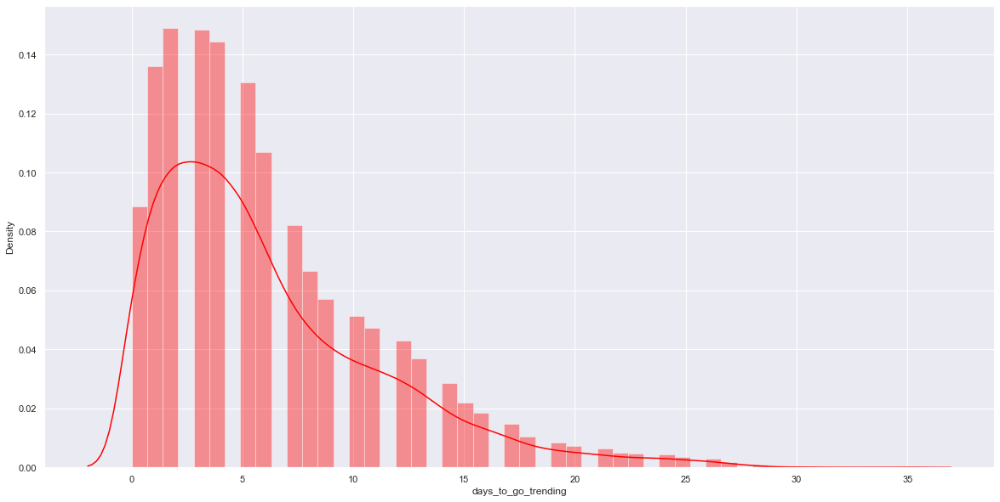

In [51]:
gv3 = sns.distplot(a=us_days_to_go_trending2018['days_to_go_trending'],color='red')

In [48]:
#2020
youtube_1 = df[(df['publish_year']==2020)&(df['Country']=='United States')]
youtube_videos = youtube_1.groupby(['title','video_id','Country','view_count','days_to_go_trending']).sum().reset_index()
us = youtube_videos[['title','video_id','Country','view_count','days_to_go_trending']].sort_values(by='days_to_go_trending',ascending=False)
b = us['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
a = us.drop(columns=['days_to_go_trending'])
us_days_to_go_trending2020 = pd.concat([a,b],axis=1)
us_days_to_go_trending2020 = us_days_to_go_trending2020.replace({'days_to_go_trending':-1},0)
us2020_1 = us_days_to_go_trending2020[us_days_to_go_trending2020['days_to_go_trending']<=8]
us2020_2 = us_days_to_go_trending2020[us_days_to_go_trending2020['days_to_go_trending']>8]

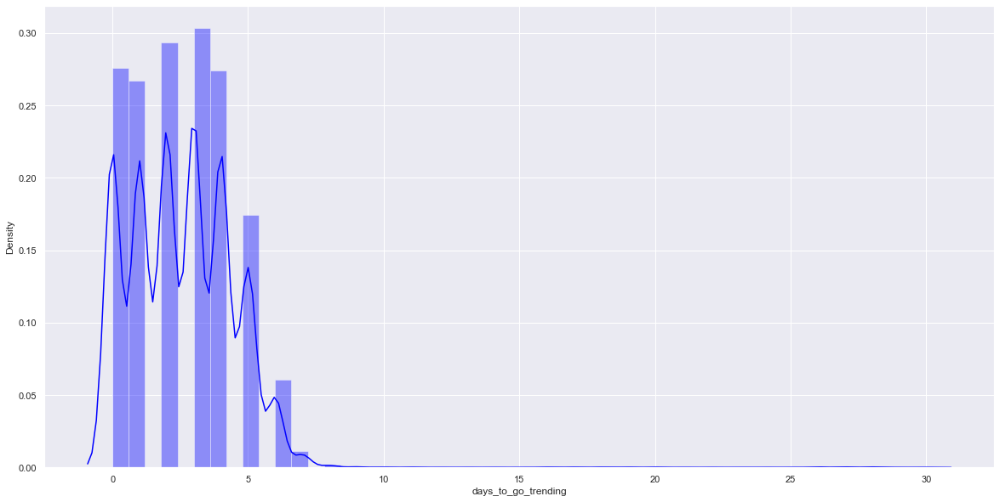

In [49]:
gb3 = sns.distplot(a=us_days_to_go_trending2020['days_to_go_trending'],color='blue')

## Top Trending Videos in Japan

In [ ]:
youtube_4 = df[(df['publish_year']==2018)&(df['Country']=='Japan')]
youtube_videos_4 = youtube_4.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
jp = youtube_videos_4[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=False)
d = jp['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
c = jp.drop(columns=['days_to_go_trending'])
jp_days_to_go_trending2018 = pd.concat([c,d],axis=1).head(6)
jp_days_to_go_trending2018 = jp_days_to_go_trending2018.replace({'days_to_go_trending':-1},0)
jp_days_to_go_trending2018.head()

,title,video_id,Country,view_count,Category_name,days_to_go_trending
2929,YURA MIN & GAMELIN ALEXANDER 민유라 & 알렉산더 겜린 @ 2...,CPo_NSjSGmE,Japan,217989,Sports,37
4558,【すごい】特大の雷が光りまくる岡崎市の夜,U29bGfVe1sg,Japan,299514,Entertainment,31
1601,Gabriella Papadakis/ Guillaume Cizeron Europea...,0Q0Qk18JtDo,Japan,1096557,Sports,31
4557,【すごい】特大の雷が光りまくる岡崎市の夜,U29bGfVe1sg,Japan,210515,Entertainment,30
8958,ジャニーズでの居場所がなくなった風間俊介 沸騰ワード,nef7i0Pg4RY,Japan,23257,Entertainment,29


In [ ]:
youtube_2 = df[(df['publish_year']==2020)&(df['Country']=='Japan')]
youtube_videos_2 = youtube_2.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
jp = youtube_videos_2[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=False)
d = jp['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
c = jp.drop(columns=['days_to_go_trending'])
jp_days_to_go_trending2020 = pd.concat([c,d],axis=1).head(8)
jp_days_to_go_trending2020 = jp_days_to_go_trending2020.replace({'days_to_go_trending':-1},0)
jp_days_to_go_trending2020.head()


,title,video_id,Country,view_count,Category_name,days_to_go_trending
8602,お昼ごはん,p_gzVnkaMZ4,Japan,270232,People & Blogs,11
12721,猫に催眠術をかけてみた（保護猫）,d-Ouk3XmXW4,Japan,101394,People & Blogs,11
8601,お昼ごはん,p_gzVnkaMZ4,Japan,263753,People & Blogs,10
4009,【ご報告】ンダホ、子どもが産まれていました！,yVDvw_gNbss,Japan,6809498,Entertainment,10
12720,猫に催眠術をかけてみた（保護猫）,d-Ouk3XmXW4,Japan,101324,People & Blogs,10


## The longeset time for videos to go trending

[Text(0, 0, 'YURA MIN & GAMELIN ALEXANDER 민유라 & 알렉산더 겜린 @ 2018년 피겨 종합선수권 아댄시니어 SD #01'),
 Text(1, 0, '【すごい】特大の雷が光りまくる岡崎市の夜'),
 Text(2, 0, 'Gabriella Papadakis/ Guillaume Cizeron European Championships 2018 SD B.ESP'),
 Text(3, 0, 'ジャニーズでの居場所がなくなった風間俊介 沸騰ワード'),
 Text(4, 0, 'P・A・R・A・D・O・X')]

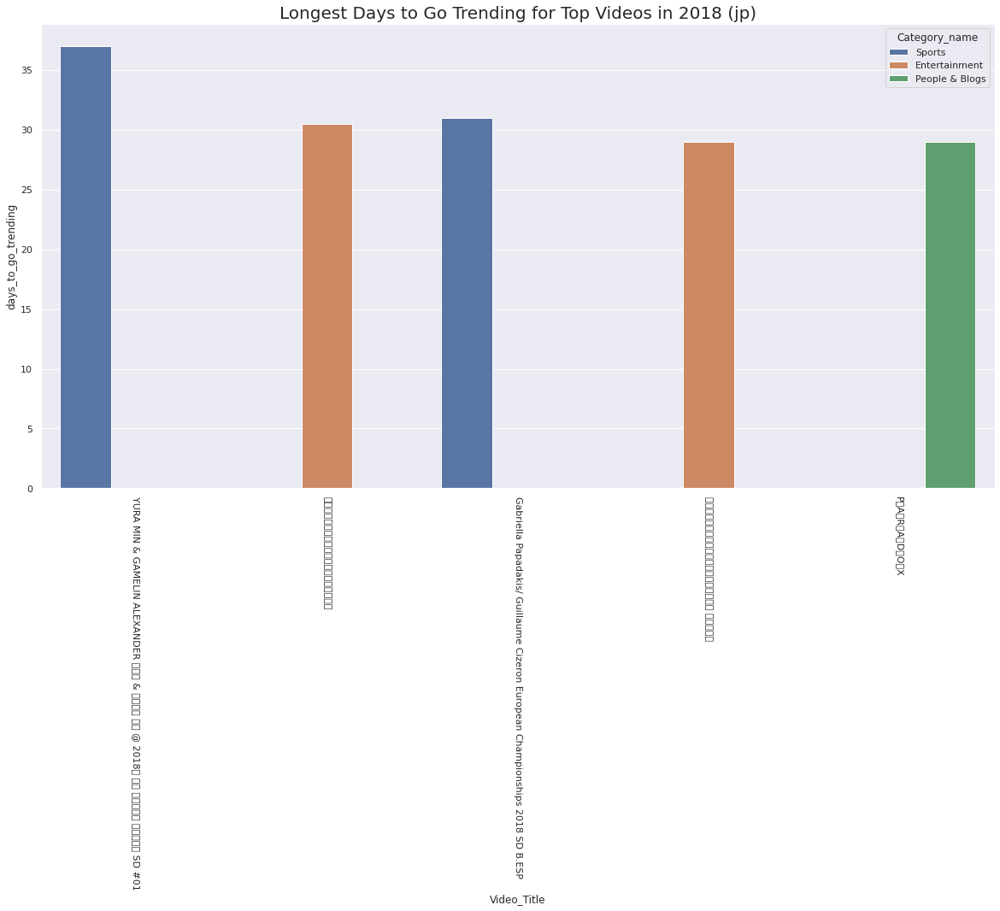

In [ ]:
gv3 = sns.barplot(y='days_to_go_trending',x='title',data=jp_days_to_go_trending2018,ci=None,hue='Category_name')
gv3.set(xlabel='Video_Title',ylabel='days_to_go_trending')
gv3.set_title('Longest Days to Go Trending for Top Videos in 2018 (jp)',size=20)
gv3.set_xticklabels(gv3.get_xticklabels(), rotation=-90)

[Text(0, 0, 'お昼ごはん'),
 Text(1, 0, '猫に催眠術をかけてみた（保護猫）'),
 Text(2, 0, '【ご報告】ンダホ、子どもが産まれていました！'),
 Text(3, 0, "IZ*ONE (아이즈원) - 'Beware' MV"),
 Text(4, 0, '【A・NA・TA for DREAM】嵐がやってみた 〜大野智ver.〜')]

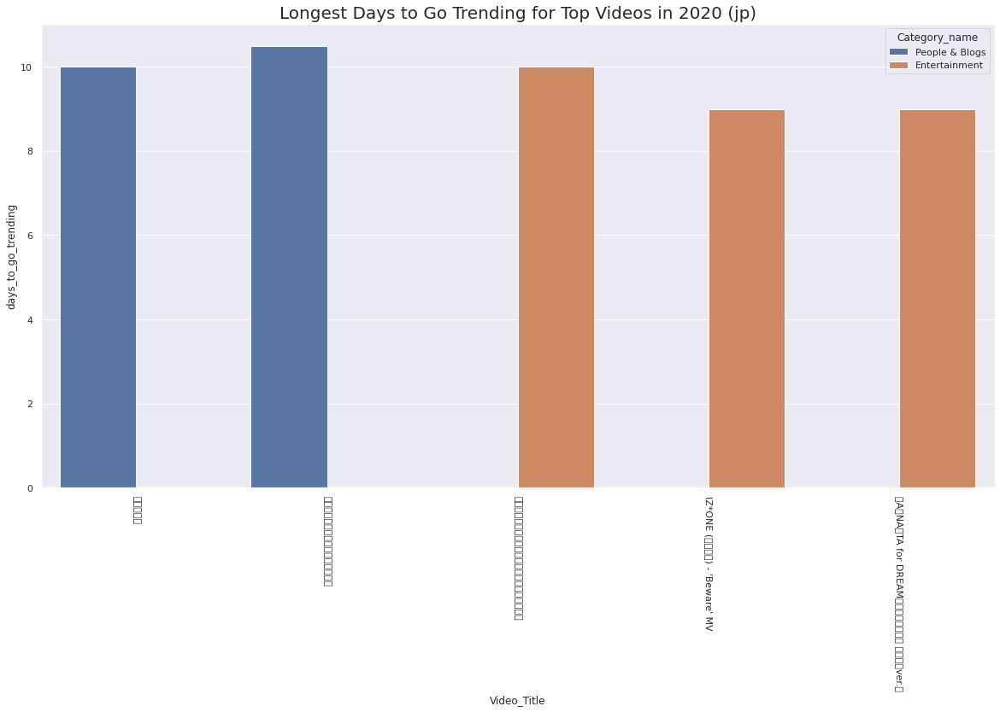

In [ ]:
gv4 = sns.barplot(y='days_to_go_trending',x='title',data=jp_days_to_go_trending2020,ci=None,hue='Category_name')
gv4.set(xlabel='Video_Title',ylabel='days_to_go_trending')
gv4.set_title('Longest Days to Go Trending for Top Videos in 2020 (jp)',size=20)
gv4.set_xticklabels(gv4.get_xticklabels(), rotation=-90)


## The shortest time for videos to go trending



In [ ]:
youtube_2 = df[(df['publish_year']==2018)&(df['Country']=='Japan')]
youtube_videos_2 = youtube_2.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
jp = youtube_videos_2[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=True)
d = jp['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
c = jp.drop(columns=['days_to_go_trending'])
jp_days_to_go_trending = pd.concat([c,d],axis=1)
jp_days_to_go_trending_min2018 = jp_days_to_go_trending.replace({'days_to_go_trending':-1},0).head(15)
jp_days_to_go_trending_min2018.head()


,title,video_id,Country,view_count,Category_name,days_to_go_trending
13961,超怖い心霊 ghost live,ynEN3LqUuZQ,Japan,19783,Entertainment,0
2251,Phillip Butters en Exitosa | PAOLO GUERRERO SI...,6EzD_2AtPo4,Japan,84249,People & Blogs,0
9752,ポンコツクエスト～魔王と派遣の魔物たち～第五十章「遭難」,WIdQyd0Dq-s,Japan,34613,Film & Animation,0
10,#1023 Chopper & Usopp try to save Robin - Stra...,rPJ7aYOoRf8,Japan,208337,Film & Animation,0
11,#1023 Chopper & Usopp try to save Robin - Stra...,rPJ7aYOoRf8,Japan,208369,Film & Animation,0


In [ ]:
youtube_2 = df[(df['publish_year']==2020)&(df['Country']=='Japan')]
youtube_videos_2 = youtube_2.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
jp = youtube_videos_2[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=True)
d = jp['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
c = jp.drop(columns=['days_to_go_trending'])
jp_days_to_go_trending = pd.concat([c,d],axis=1)
jp_days_to_go_trending_min2020 = jp_days_to_go_trending.replace({'days_to_go_trending':-1},0).head(20)
jp_days_to_go_trending_min2020.head()

,title,video_id,Country,view_count,Category_name,days_to_go_trending
6481,【当時の衣装アリ】【暗記用】ミニモニ。のロックンロール県庁所在地～おぼえちゃいなシリーズ～を...,Pdg2R8AnEvs,Japan,592646,People & Blogs,0
2455,au PAY マーケット x 乃木坂46「賀喜遥香の驚愕」（ポイント交換）,uef8orf4dBo,Japan,138539,Science & Technology,0
2723,「不二家LOOK Smile Switch」篇 30秒 2020年9月,5t_5REP5VLw,Japan,283012,People & Blogs,0
2732,「不二家洋菓子店 Smile Switch」篇 30秒 2020年9月,y2d1XhuJbSw,Japan,131598,People & Blogs,0
856,Dynamite (EDM Remix),nQEnj84irFc,Japan,1223879,Music,0


Text(0.5, 1.0, 'Shortest Days Go Trending for Top Videos 2018(JP)')

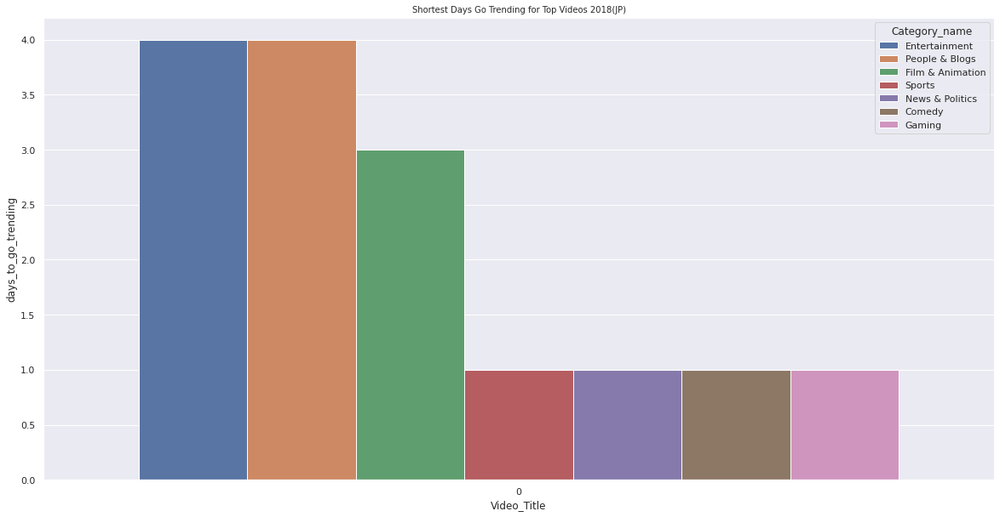

In [ ]:
import plotly.express as px  
fig_jp2018= px.scatter(jp_days_to_go_trending_min2018, x= 'days_to_go_trending', y= 'title',color='Category_name',title='Shortest Days Go Trending for Top Videos 2018(JP)')
fig_jp2018.show()

Text(0.5, 1.0, 'Shortest Days Go Trending for Top Videos 2020(JP)')

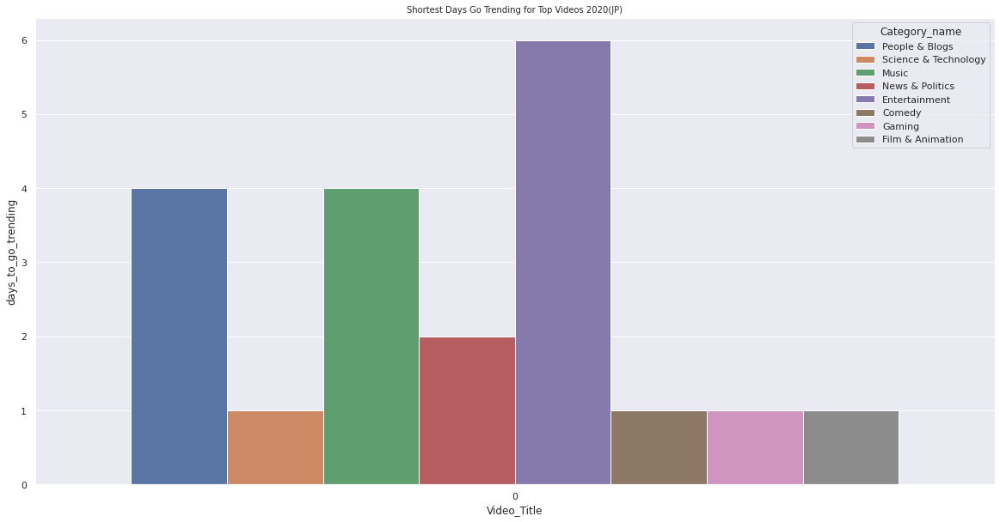

In [ ]:
fig_jp2020= px.scatter(jp_days_to_go_trending_min2020, x= 'days_to_go_trending', y= 'title',color='Category_name',title='Shortest Days Go Trending for Top Videos 2020(JP)')
fig_jp2020.show()

# How many videos are in each day interval

In [ ]:
#2018
youtube_4 = df[(df['publish_year']==2018)&(df['Country']=='Japan')]
youtube_videos_4 = youtube_4.groupby(['title','video_id','Country','view_count','days_to_go_trending','Category_name']).sum().reset_index()
jp = youtube_videos_4[['title','video_id','Country','view_count','days_to_go_trending','Category_name']].sort_values(by='days_to_go_trending',ascending=False)
d = jp['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
c = jp.drop(columns=['days_to_go_trending'])
jp_days_to_go_trending2018 = pd.concat([c,d],axis=1)
jp_days_to_go_trending2018 = jp_days_to_go_trending2018.replace({'days_to_go_trending':-1},0)
jp2018_1 = jp_days_to_go_trending2018[jp_days_to_go_trending2018['days_to_go_trending']<=1]
jp2018_2 = jp_days_to_go_trending2018[jp_days_to_go_trending2018['days_to_go_trending']>1]

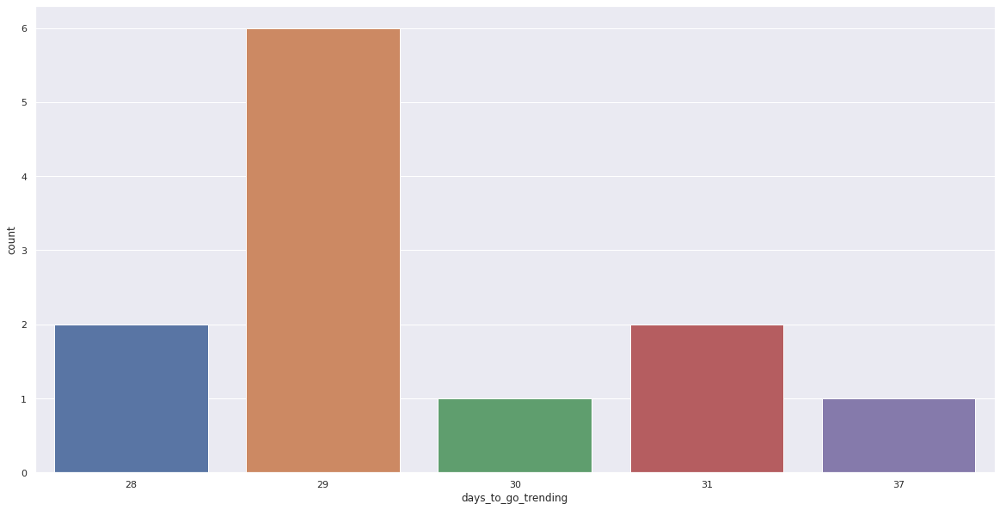

In [ ]:
gb1 = sns.distplot(a=jp_days_to_go_trending2018['days_to_go_trending'],color='yellow')

In [ ]:
#2020
youtube_2 = df[(df['publish_year']==2020)&(df['Country']=='Japan')]
youtube_videos_2 = youtube_2.groupby(['title','video_id','Country','view_count','days_to_go_trending']).sum().reset_index()
jp = youtube_videos_2[['title','video_id','Country','view_count','days_to_go_trending']].sort_values(by='days_to_go_trending',ascending=False)
d = jp['days_to_go_trending'].astype('timedelta64[D]').astype('int64')
c = jp.drop(columns=['days_to_go_trending'])
jp_days_to_go_trending2020 = pd.concat([c,d],axis=1)
jp_days_to_go_trending2020 = jp_days_to_go_trending2020.replace({'days_to_go_trending':-1},0)
jp_days_to_go_trending2020.head() 

,title,video_id,Country,view_count,days_to_go_trending
8602,お昼ごはん,p_gzVnkaMZ4,Japan,270232,11
12721,猫に催眠術をかけてみた（保護猫）,d-Ouk3XmXW4,Japan,101394,11
8601,お昼ごはん,p_gzVnkaMZ4,Japan,263753,10
4009,【ご報告】ンダホ、子どもが産まれていました！,yVDvw_gNbss,Japan,6809498,10
12720,猫に催眠術をかけてみた（保護猫）,d-Ouk3XmXW4,Japan,101324,10


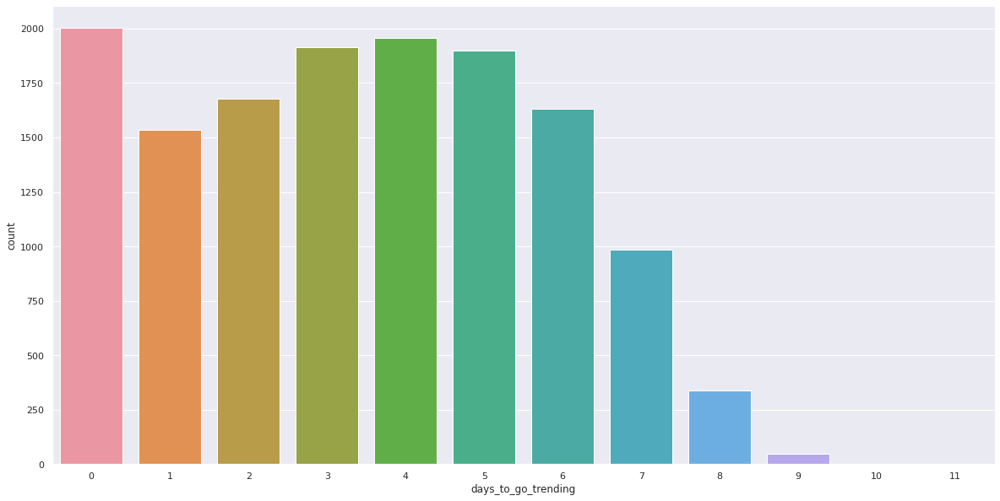

In [ ]:
gb2 = sns.distplot(a=jp_days_to_go_trending2020['days_to_go_trending'],color='purple')

## Top Popular Videos in Both Countries(By Japan View Count & By US View Count)

In [53]:
corr_jp = youtube_jp.groupby(['title','video_id','Category_name','categoryId','Country','view_count']).sum().reset_index()
jp = corr_jp[['title','video_id','Category_name','categoryId','Country','view_count']].sort_values(by='view_count',ascending=False)
corr_us = youtube_us.groupby(['title','video_id','Category_name','categoryId','Country','view_count']).sum().reset_index()
us = corr_us[['title','video_id','Category_name','categoryId','Country','view_count']].sort_values(by='view_count',ascending=False)
jp_us = jp.merge(us,on=['title','video_id'],how='inner')
a = jp_us.sort_values('view_count_x',ascending=False).head(500)
a.drop_duplicates()

,title,video_id,Category_name_x,categoryId_x,Country_x,view_count_x,Category_name_y,categoryId_y,Country_y,view_count_y
0,BTS (방탄소년단) 'Dynamite' Official MV,gdZLi9oWNZg,Music,10,Japan,262319276,Music,10,United States,232649205
2,BTS (방탄소년단) 'Dynamite' Official MV,gdZLi9oWNZg,Music,10,Japan,262319276,Music,10,United States,208581468
3,BTS (방탄소년단) 'Dynamite' Official MV,gdZLi9oWNZg,Music,10,Japan,262319276,Music,10,United States,200692965
4,BTS (방탄소년단) 'Dynamite' Official MV,gdZLi9oWNZg,Music,10,Japan,262319276,Music,10,United States,183414472
5,BTS (방탄소년단) 'Dynamite' Official MV,gdZLi9oWNZg,Music,10,Japan,262319276,Music,10,United States,160510938
...,...,...,...,...,...,...,...,...,...,...
602,Justin Bieber - Holy ft. Chance The Rapper,pvPsJFRGleA,Music,10,Japan,34763996,Music,10,United States,40157565
592,Justin Bieber - Holy ft. Chance The Rapper,pvPsJFRGleA,Music,10,Japan,34763996,Music,10,United States,49814886
601,Justin Bieber - Holy ft. Chance The Rapper,pvPsJFRGleA,Music,10,Japan,34763996,Music,10,United States,41347429
593,Justin Bieber - Holy ft. Chance The Rapper,pvPsJFRGleA,Music,10,Japan,34763996,Music,10,United States,48943776


[Text(0, 0, "BTS (방탄소년단) 'Dynamite' Official MV"),
 Text(0, 0, "BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V"),
 Text(0, 0, 'BLACKPINK – ‘Lovesick Girls’ M/V'),
 Text(0, 0, 'Cardi B - WAP feat. Megan Thee Stallion [Official Music Video]'),
 Text(0, 0, "BTS (방탄소년단) 'FAKE LOVE' Official MV"),
 Text(0, 0, "BTS (방탄소년단) 'Dynamite' Official Teaser"),
 Text(0, 0, "NCT U 엔시티 유 'Make A Wish (Birthday Song)' MV"),
 Text(0, 0, 'Apple Event — October 13'),
 Text(0, 0, "BTS (방탄소년단) 'Dynamite' Official MV (B-side)"),
 Text(0, 0, 'Stray Kids Back Door M/V'),
 Text(0, 0, 'DJ Khaled ft. Drake - POPSTAR (Official Music Video - Starring Justin Bieber)'),
 Text(0, 0, 'VENOM - Official Trailer (HD)'),
 Text(0, 0, 'Justin Bieber - Holy ft. Chance The Rapper')]

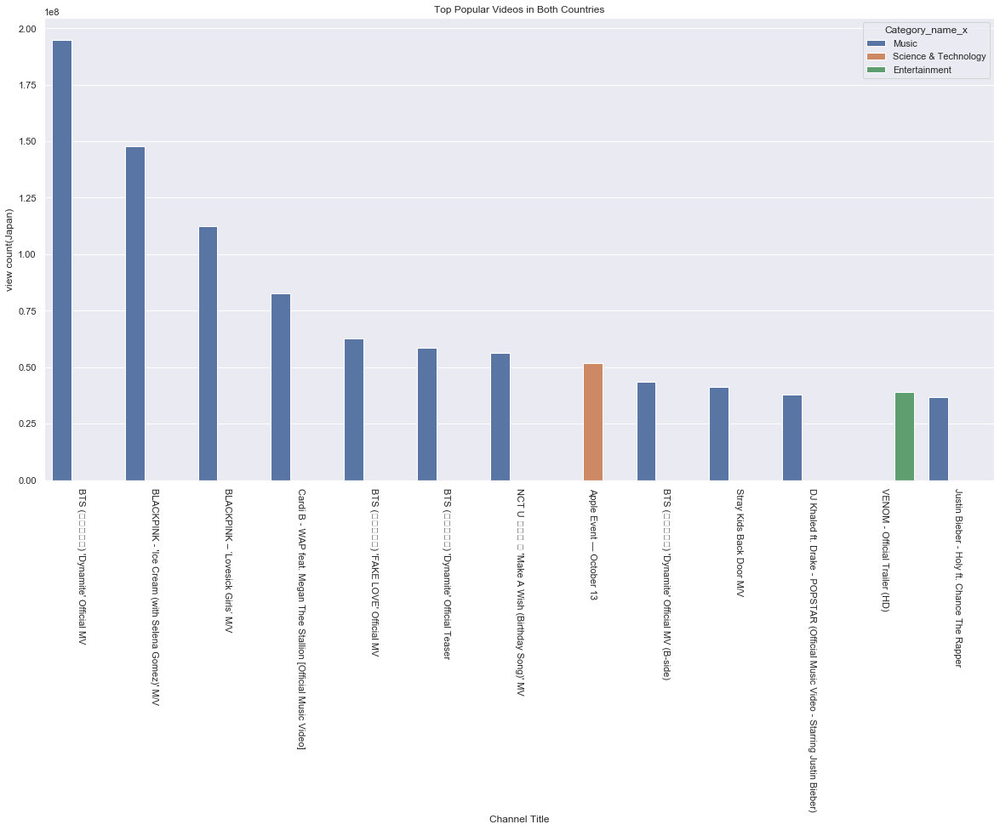

In [54]:
## Top Popular Videos in Both Countries(Japan View Count)
g = sns.barplot(x='title',y='view_count_x',data=a,ci=None,hue='Category_name_x')
g.set(xlabel='Channel Title',ylabel='view count(Japan)')
g.set_title('Top Popular Videos in Both Countries')
g.set_xticklabels(g.get_xticklabels(), rotation=-90)

[Text(0, 0, "BTS (방탄소년단) 'Dynamite' Official MV"),
 Text(0, 0, "BLACKPINK - 'Ice Cream (with Selena Gomez)' M/V"),
 Text(0, 0, 'BLACKPINK – ‘Lovesick Girls’ M/V'),
 Text(0, 0, 'Cardi B - WAP feat. Megan Thee Stallion [Official Music Video]'),
 Text(0, 0, "BTS (방탄소년단) 'FAKE LOVE' Official MV"),
 Text(0, 0, "BTS (방탄소년단) 'Dynamite' Official Teaser"),
 Text(0, 0, "NCT U 엔시티 유 'Make A Wish (Birthday Song)' MV"),
 Text(0, 0, 'Apple Event — October 13'),
 Text(0, 0, "BTS (방탄소년단) 'Dynamite' Official MV (B-side)"),
 Text(0, 0, 'Stray Kids Back Door M/V'),
 Text(0, 0, 'DJ Khaled ft. Drake - POPSTAR (Official Music Video - Starring Justin Bieber)'),
 Text(0, 0, 'VENOM - Official Trailer (HD)'),
 Text(0, 0, 'Justin Bieber - Holy ft. Chance The Rapper')]

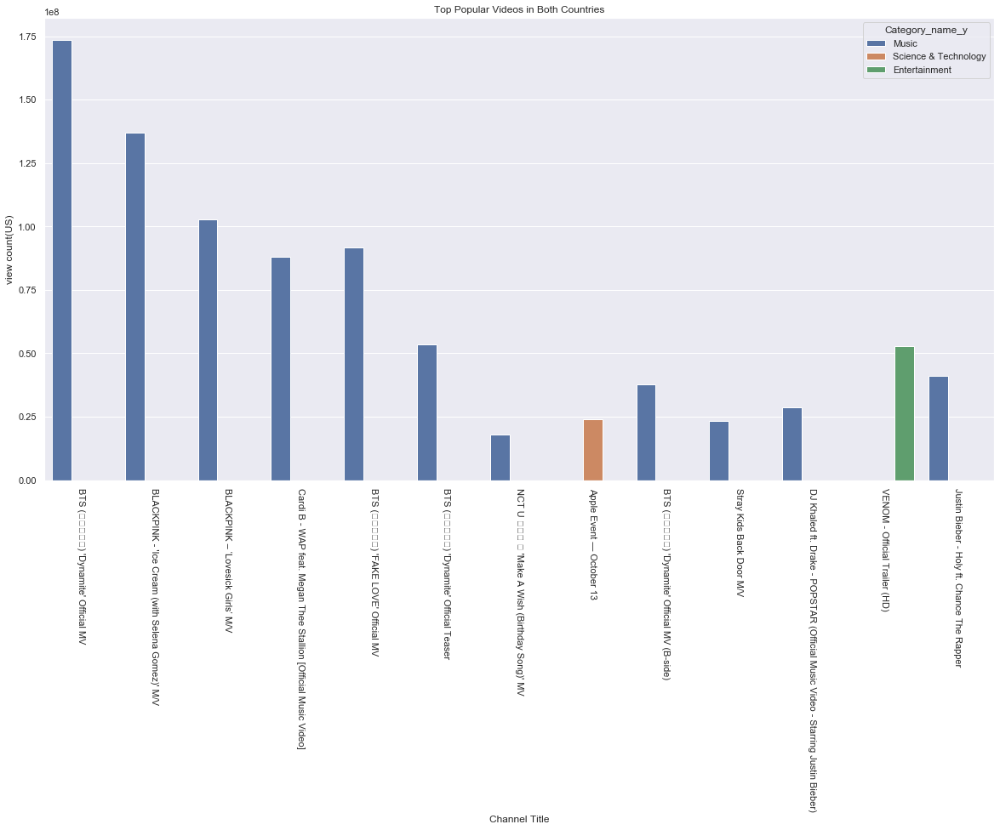

In [55]:
## Top Popular Videos in Both Countries(Japan View Count)
g = sns.barplot(x='title',y='view_count_y',data=a,ci=None,hue='Category_name_y')
g.set(xlabel='Channel Title',ylabel='view count(US)')
g.set_title('Top Popular Videos in Both Countries')
g.set_xticklabels(g.get_xticklabels(), rotation=-90)

# YouTube Channels Analysis

## Top 5 Most Viewed Channels in 2018 for US and Japan

We filter our dataset for the year 2018 and searched for each country top 5 channels with the hightest views.

In [ ]:
df_youtube = df.copy()
youtube2018 = df_youtube[df_youtube['publish_year'] == 2018]
youtube2018.set_index(['Country','channelTitle'], inplace=True)
channels2018 = youtube2018.groupby(['Country','channelTitle']).agg({'view_count':'sum'}).sort_values(by='view_count', ascending=False).reset_index()
top_channels2018 = channels2018.groupby('Country').head()
top_channels2018

,Country,channelTitle,view_count
0,United States,ChildishGambinoVEVO,3758488765
1,United States,ibighit,2011897203
2,United States,Dude Perfect,1718793377
3,United States,ArianaGrandeVevo,1576959172
4,United States,MalumaVEVO,1551515831
144,Japan,ibighit,138038653
176,Japan,Marvel Entertainment,113003383
226,Japan,Sony Pictures Entertainment,78585868
229,Japan,TaylorSwiftVEVO,78166154
235,Japan,MLG Highlights,75567747


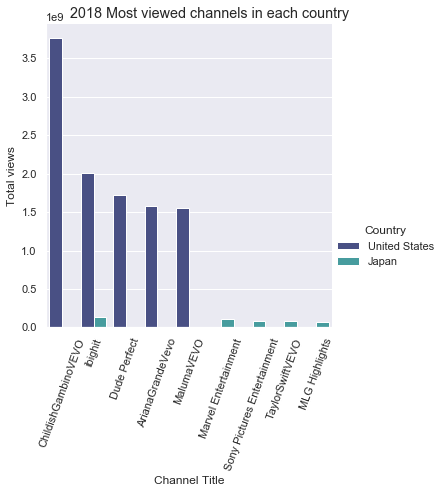

In [ ]:
g2018 = sns.catplot(x='channelTitle',y='view_count', data = top_channels2018, hue= 'Country',kind='bar', palette='mako')
g2018.set_xticklabels(rotation=70)
g2018.fig.suptitle('2018 Most viewed channels in each country')
g2018.set(xlabel='Channel Title', ylabel='Total views')

As presented, the top Japan and US channels are related to the music and entertainment categories. Moreover, we can see they share one channel which is ibighit. Ibighit is a South Korean entertainment company that manages idol groups BTS and TXT.

Also, we can see that US channels have more views being the top having 3 billion views compare to Japan first video which has 138 Millions. 

## Top 5 Most Viewed Channels in 2020 for US and Japan

We did something similar for 2020.  We can see a trend which is that Japan and US top channels are still in the music and entertainment categories. However, Japan presents Apple channel which goes with the Technology category.

In [ ]:
youtube2020 = df_youtube[df_youtube['publish_year'] == 2020]
youtube2020.set_index(['Country','channelTitle'], inplace=True)
channels2020 = youtube2020.groupby(['Country','channelTitle']).agg({'view_count':'sum'}).sort_values(by=['Country','view_count'], ascending=[False,False]).reset_index()
top_channels2020 = channels2020.groupby('Country').head()
top_channels2020

,Country,channelTitle,view_count
0,United States,BLACKPINK,2522068915
1,United States,Big Hit Labels,2075636433
2,United States,MrBeast,1411587353
3,United States,JustinBieberVEVO,1033585854
4,United States,MrBeast Gaming,814628805
1415,Japan,Big Hit Labels,2972398551
1416,Japan,BLACKPINK,2841162351
1417,Japan,SMTOWN,666075571
1418,Japan,JYP Entertainment,590275138
1419,Japan,Apple,518280387


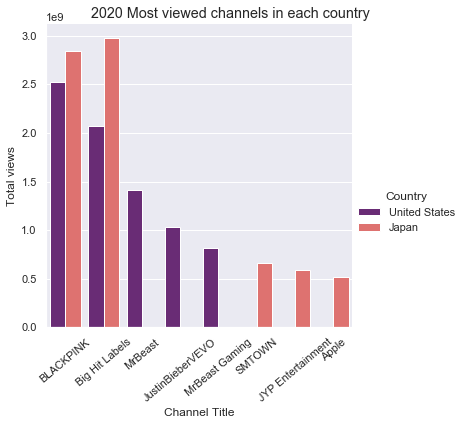

In [ ]:
g2020 = sns.catplot(x='channelTitle',y='view_count', data = top_channels2020, hue= 'Country',kind='bar', palette='magma')
g2020.set_xticklabels(rotation=40)
g2020.fig.suptitle('2020 Most viewed channels in each country')
g2020.set(xlabel='Channel Title', ylabel='Total views')

Moreover, we can see that now they share more than one channel:

1) BLACKPINK

2) Big Hit Labels

Both are related to Japan music industry. One interesting finding: For 2020, Japan channels have more views than US channels. 

## Channel Statistics for 2020

### Youtube API

We used YouTube Data API to retrieve more information regarding 2020 top 5 channels of each country.

In [ ]:
#install
! pip install google-api-python-client

In [ ]:
from googleapiclient.discovery import build
youtubeApiKey = '' ##Deleted the API Key for security purposes
youtube_api = build('youtube','v3',developerKey=youtubeApiKey)

Retrieve channel Id for the top channels in 2020 so we can send it to the YouTube API and obtain the channel statistics  

In [ ]:
channel_titles = list(top_channels2020['channelTitle'])
youtube2020.reset_index(inplace=True)
channel_list = list(youtube2020[youtube2020['channelTitle'].isin(channel_titles)]['channelId'].unique())
print(channel_list)

['UCE_M8A5yxnLfW0KghEeajjw', 'UCEf_Bc-KVd7onSeifS3py9g', 'UCX6OQ3DkcsbYNE6H8uQQuVA', 'UCOmHUn--16B90oW2L6FRR3A', 'UC3IZKseVpdzPSBaWxBxundA', 'UCIPPMRA040LQr5QPyJEbmXA', 'UCHkj014U2CQ2Nv0UZeYpE_A', 'UCaO6TYtlC8U5ttz62hTrZgg']


In [ ]:
def getChannelStatistics(youtube_api, unique_channels):
    channels = []
    viewCount = []
    subscriberCount = []
    videoCount = []
    channel_stats = []
    for channel in unique_channels:
        channelstats = youtube_api.channels().list(part="statistics", id = channel).execute()
        if 'items' in channelstats:    
            viewCount = channelstats['items'][0]['statistics']['viewCount']
            hiddenSubscriber = channelstats['items'][0]['statistics']['hiddenSubscriberCount']
            if hiddenSubscriber == False:
                subscriberCount = channelstats['items'][0]['statistics']['subscriberCount']
            else:
                subscriberCount = ''
            videoCount = channelstats['items'][0]['statistics']['videoCount']
            dic = {'id': channel, 'viewCount': viewCount, 'subscriberCount': subscriberCount, 'videoCount': videoCount}
            channels.append(dic)
  
    df_channel_statsUS = pd.DataFrame(channels)
    return df_channel_statsUS

In [ ]:
df_channels_stats = getChannelStatistics(youtube_api, channel_list)

The columns were created with dtype "Object". Hence, we need to convert it to integer so we are able to analize it

In [ ]:
df_channels_stats['viewCount'] = df_channels_stats['viewCount'].astype(int)
df_channels_stats['videoCount'] = df_channels_stats['videoCount'].astype(int)
df_channels_stats['subscriberCount'] = df_channels_stats['subscriberCount'].astype(int)
df_channels_stats.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8 entries, 0 to 7
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   id               8 non-null      object
 1   viewCount        8 non-null      int64 
 2   subscriberCount  8 non-null      int64 
 3   videoCount       8 non-null      int64 
dtypes: int64(3), object(1)
memory usage: 384.0+ bytes


In [ ]:
df_channels_stats = df_channels_stats.sort_values(by=['viewCount','subscriberCount','videoCount'], ascending=[False, False,False])
df_channels_stats

,id,viewCount,subscriberCount,videoCount
6,UCHkj014U2CQ2Nv0UZeYpE_A,21551455475,32400000,163
1,UCEf_Bc-KVd7onSeifS3py9g,18723257381,25200000,3612
3,UCOmHUn--16B90oW2L6FRR3A,13800119343,53800000,324
4,UC3IZKseVpdzPSBaWxBxundA,13236709885,48700000,478
7,UCaO6TYtlC8U5ttz62hTrZgg,11172395109,19300000,1205
2,UCX6OQ3DkcsbYNE6H8uQQuVA,8009172626,46900000,695
5,UCIPPMRA040LQr5QPyJEbmXA,1026337865,10800000,79
0,UCE_M8A5yxnLfW0KghEeajjw,786562445,13700000,188


Merging the YouTube Channel Stats DataFrame to the Youtube2020 DataFrame so we can retreive the Channel Title and Category Name

In [ ]:
merged_channels_stats = df_channels_stats.merge(youtube2020, left_on='id', right_on='channelId', how='inner')
merged_channels_stats = merged_channels_stats[['id','viewCount','subscriberCount','videoCount','channelTitle','Category_name']]
merged_channels_stats.drop_duplicates(inplace=True)
merged_channels_stats

,id,viewCount,subscriberCount,videoCount,channelTitle,Category_name
0,UCHkj014U2CQ2Nv0UZeYpE_A,21551455475,32400000,163,JustinBieberVEVO,Music
39,UCEf_Bc-KVd7onSeifS3py9g,18723257381,25200000,3612,SMTOWN,Music
115,UCOmHUn--16B90oW2L6FRR3A,13800119343,53800000,324,BLACKPINK,Music
181,UCOmHUn--16B90oW2L6FRR3A,13800119343,53800000,324,BLACKPINK,Entertainment
218,UC3IZKseVpdzPSBaWxBxundA,13236709885,48700000,478,Big Hit Labels,Music
303,UCaO6TYtlC8U5ttz62hTrZgg,11172395109,19300000,1205,JYP Entertainment,Music
382,UCX6OQ3DkcsbYNE6H8uQQuVA,8009172626,46900000,695,MrBeast,Entertainment
449,UCIPPMRA040LQr5QPyJEbmXA,1026337865,10800000,79,MrBeast Gaming,Gaming
545,UCE_M8A5yxnLfW0KghEeajjw,786562445,13700000,188,Apple,Science & Technology


Text(0.5, 1.03, 'Top 10 Channels - Total Video Count')

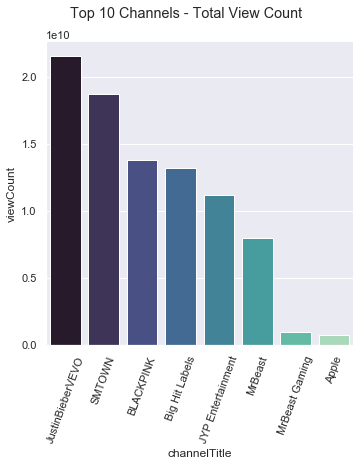

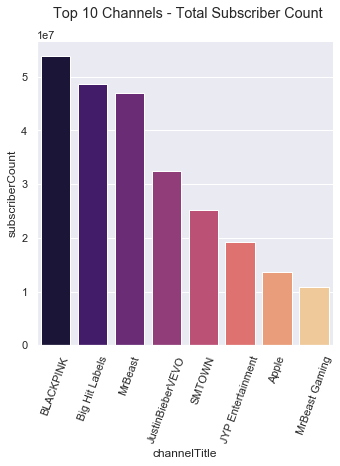

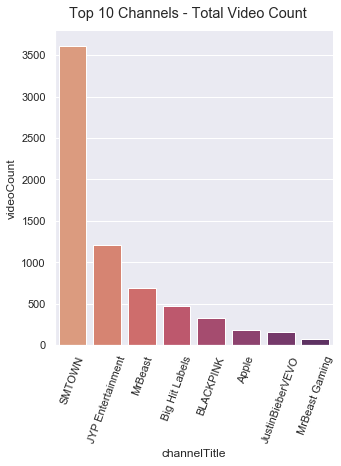

In [ ]:
merged_channels_stats_views = merged_channels_stats.groupby('channelTitle').agg({'viewCount':'mean'}).sort_values(by='viewCount', ascending=False).reset_index()
merged_channels_stats_subs = merged_channels_stats.groupby('channelTitle').agg({'subscriberCount':'mean'}).sort_values(by='subscriberCount', ascending=False).reset_index()
merged_channels_stats_videos = merged_channels_stats.groupby('channelTitle').agg({'videoCount':'mean'}).sort_values(by='videoCount', ascending=False).reset_index()
a = sns.catplot(x='channelTitle', y='viewCount', data=merged_channels_stats_views, kind='bar', palette='mako')
a.fig.suptitle('Top 10 Channels - Total View Count', y=1.03)
a.set_xticklabels(rotation=70)
b =  sns.catplot(x='channelTitle', y='subscriberCount', data=merged_channels_stats_subs, kind='bar', palette='magma')
b.set_xticklabels(rotation=70)
b.fig.suptitle('Top 10 Channels - Total Subscriber Count', y=1.03)
c =  sns.catplot(x='channelTitle', y='videoCount', data=merged_channels_stats_videos,kind='bar', palette='flare')
c.set_xticklabels(rotation=70)
c.fig.suptitle('Top 10 Channels - Total Video Count',y=1.03)

Text(0.5, 0.98, 'Relationship between the channels statistics')

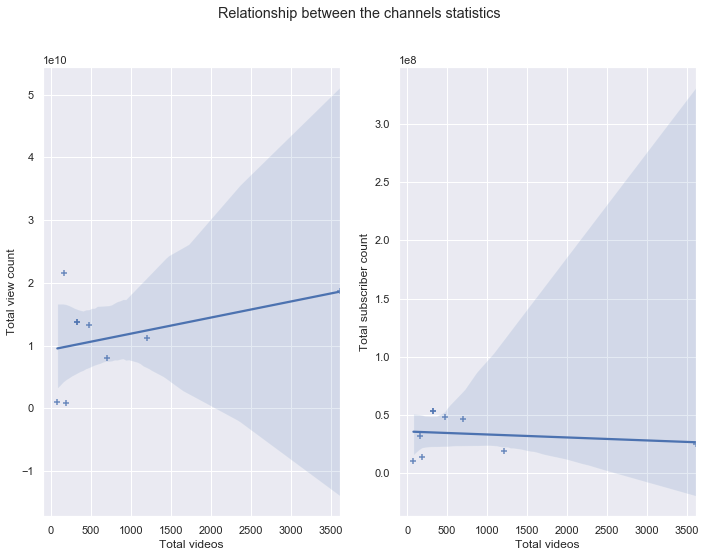

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(11.7,8.27))
x = sns.regplot(x="videoCount", y="viewCount", data=merged_channels_stats,marker="+", ax=ax[0])
x.set(xlabel='Total videos', ylabel='Total view count')
y = sns.regplot(x="videoCount", y="subscriberCount", data=merged_channels_stats,marker="+", ax=ax[1])
y.set(xlabel='Total videos', ylabel='Total subscriber count')
fig.suptitle('Relationship between the channels statistics')

We don't have much data points but we can still identify a positive relationship between the Channel total videos and total views. In other words, the more videos posted in the channel, higher is the channel views. However, we can identity a negative relationship between the channel total videos and total subscribers which means that having more videos does not mean the channel is going to have more subscribers.

Text(0.5, 0.98, 'Relationship between the channels statistics')

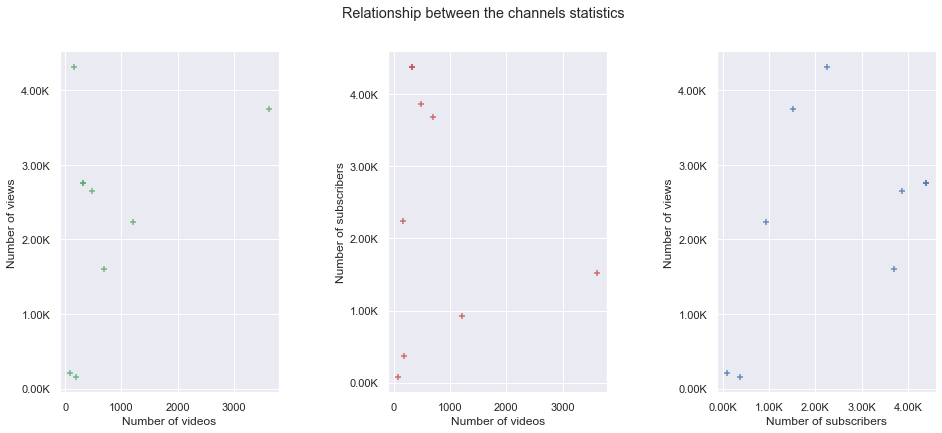

In [ ]:
fig, ax = plt.subplots(1,3,figsize=(15.7,6.27))
plt.subplots_adjust(left = 0.125, right = 0.9, wspace = 0.5)
x = sns.regplot(x="videoCount", y="viewCount", data=merged_channels_stats,marker="+", ax=ax[0], color='g',fit_reg=False)
x.set(xlabel='Number of videos', ylabel='Number of views')
ylabels_1 = ['{:,.2f}'.format(x) + 'K' for x in x.get_xticks()/1000]
x.set_yticklabels(ylabels_1)
y = sns.regplot(x="videoCount", y="subscriberCount", data=merged_channels_stats,marker="+", ax=ax[1], color='r', fit_reg=False)
ylabels_2 = ['{:,.2f}'.format(x) + 'K' for x in x.get_xticks()/1000]
y.set(xlabel='Number of videos', ylabel='Number of subscribers')
y.set_yticklabels(ylabels_2)
z = sns.regplot(x="subscriberCount", y="viewCount", data=merged_channels_stats,marker="+", ax=ax[2],color='b',fit_reg=False)
ylabels_3 = ['{:,.2f}'.format(x) + 'K' for x in x.get_xticks()/1000]
xlabels_3 = ['{:,.2f}'.format(x) + 'K' for x in x.get_xticks()/1000]
z.set(xlabel='Number of subscribers', ylabel='Number of views')
z.set_yticklabels(ylabels_3)
z.set_xticklabels(xlabels_3)
fig.suptitle('Relationship between the channels statistics')

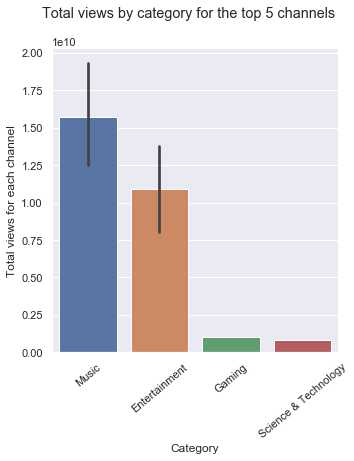

In [ ]:
g_channels_stats = sns.catplot(x="Category_name", y="viewCount", data=merged_channels_stats, kind="bar")
g_channels_stats.set_xticklabels(rotation=40)
g_channels_stats.fig.suptitle('Total views by category for the top 5 channels', y = 1.05)
g_channels_stats.set(xlabel='Category', ylabel='Total views for each channel')

## Channel Publish Analysis

Now, we can analyze the Channel Publish Time which means when the channel decided to make the video available in the YouTube Platform. First, we will analyze Japan and US together and then each country individually. 

### Channel Publish Hour Time Series for US and Japan

For this analysis, we kept the Publish time in UTC format and count how many distinct video id each channel publish in each hour. For 2018, Japan preferred publish hour was 10 am. However, for US it was around 3 pm. For 2020, we can identify a similar trend, however, the amount of channel id decrease

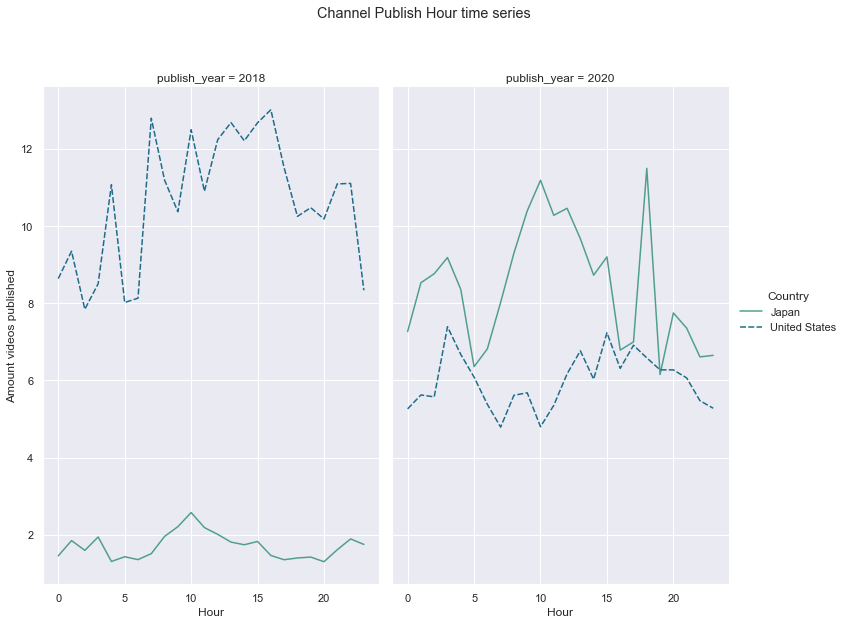

In [ ]:
channel_youtube = df.copy()
channel_youtube['publish_year'] = pd.to_datetime(df['publishedAt']).dt.year
channel_youtube['publish_hour'] = pd.to_datetime(df['publishedAt']).dt.hour
agg_channel_country = channel_youtube.groupby(['Country','channelTitle','publish_year','publish_hour']).agg({'video_id':'count'})
g_channeltime = sns.relplot(x='publish_hour', y='video_id', data = agg_channel_country, kind='line' , hue='Country',style='Country',col='publish_year', ci=None, palette="crest")
g_channeltime.fig.suptitle('Channel Publish Hour time series', y=1.06)
g_channeltime.set(xlabel='Hour', ylabel='Amount videos published')
g_channeltime.fig.set_size_inches(11.7, 8.27)

#### Japan Channel Publish Hours

We formatted the Publish Time to Asia/Tokio timezone (9 more hours).

Total records analized: 13997

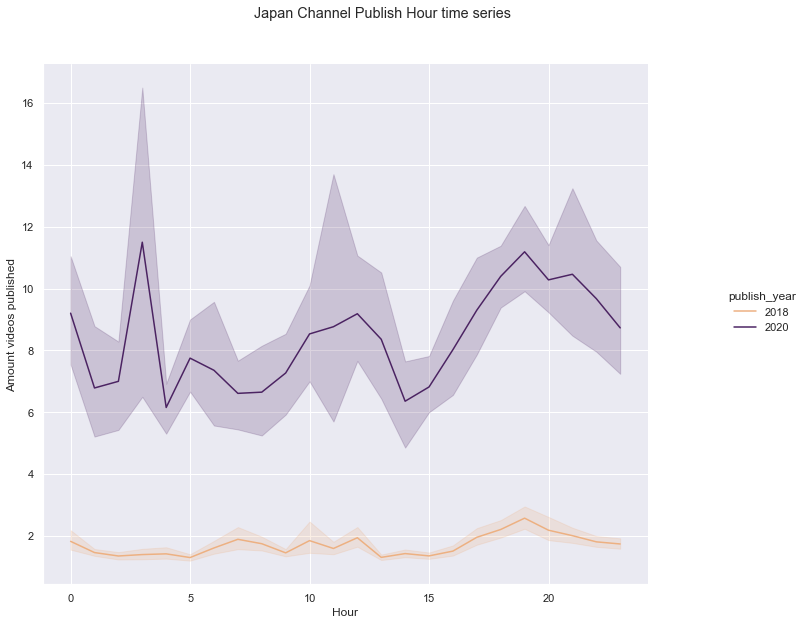

In [ ]:
hours = 9 
hours_added = dt.timedelta(hours=hours)

jp_youtube = df.copy()
jp_youtube = jp_youtube[jp_youtube['Country'] == 'Japan']
jp_youtube = jp_youtube.drop_duplicates()
publish_datetime = list(jp_youtube['publish_datetime'])
jp_youtube.reset_index(drop=True,inplace=True)
#jp_youtube.shape

video_id = list(jp_youtube['video_id'])
publish_date_format = []
for date in publish_datetime:
    hours = 9 
    hours_added = dt.timedelta(hours=hours)
    new_date = date + hours_added
    publish_date_format.append(new_date)
jp_youtube['publish_date_formatted'] = publish_date_format
jp_youtube['publish_hour_format'] = pd.to_datetime(jp_youtube['publish_date_formatted']).dt.hour
#jp_youtube.shape

agg_channel_jp = jp_youtube.groupby(['publish_year','publish_hour_format','channelTitle']).agg({'video_id':'count'})
g_channel_jp = sns.relplot(x='publish_hour_format', y='video_id', data = agg_channel_jp, kind='line',hue='publish_year', palette="flare")
g_channel_jp.fig.suptitle('Japan Channel Publish Hour time series', y=1.06)
g_channel_jp.set(xlabel='Hour', ylabel='Amount videos published')
g_channel_jp.fig.set_size_inches(11.7, 8.27)

 We can see that for 2020 the prefered publish hours are early in the morning (3-5 am) and at late afternoon around 5-6 pm.

#### United States Channel Publish Hours

We formatted the Publish Time to US/Los Angeles, CA timezone (8 more less). We decided to compare it against this timezone because it's Youtube Headquarters and were most viewers are located. Perhaps, the area with more channel owners.

Total records analized: 12797

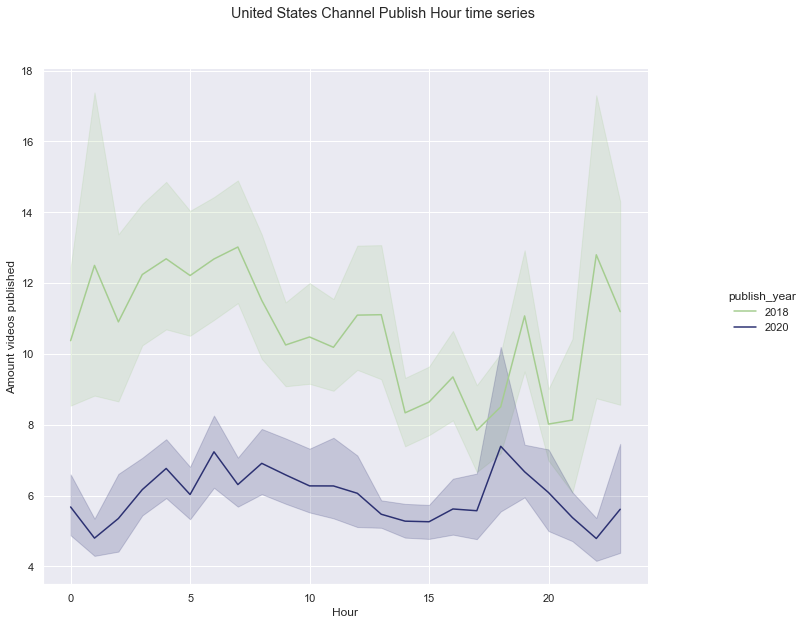

In [ ]:
CA_hours = 8
hours_substract = dt.timedelta(hours=CA_hours)
us_youtube = df.copy()
us_youtube = us_youtube[us_youtube['Country'] == 'United States']
us_youtube = us_youtube.drop_duplicates()
publish_datetime_jp = list(us_youtube['publish_datetime'])
us_youtube.reset_index(drop=True,inplace=True)
#us_youtube.shape

publish_datetime_us = list(us_youtube['publish_datetime'])
video_id_us = list(us_youtube['video_id'])
publish_date_format_us = []
for date in publish_datetime_us:
    hours = 9 
    hours_added = dt.timedelta(hours=hours)
    new_date = date - hours_added
    publish_date_format_us.append(new_date)
us_youtube['publish_date_formatted'] = publish_date_format_us
us_youtube['publish_hour_format'] = pd.to_datetime(us_youtube['publish_date_formatted']).dt.hour
#us_youtube.shape

#sns.set(rc={'figure.figsize':(20,10)})
agg_channel_us = us_youtube.groupby(['publish_year','publish_hour_format','channelTitle']).agg({'video_id':'count'})
g_channelus = sns.relplot(x='publish_hour_format', y='video_id', data = agg_channel_us, kind='line', hue='publish_year', palette='crest')
g_channelus.fig.suptitle('United States Channel Publish Hour time series', y=1.06)
g_channelus.set(xlabel='Hour', ylabel='Amount videos published')
g_channelus.fig.set_size_inches(11.7, 8.27)

We can see that the channels preferred publish hours increase in the early morning and then another peak around 5-6pm. We can see one similarity with Japan: There is a morning and late afternoon peak. However, the morning peaks are at 3-4 am and 7-8 am approximately. 

We can assume the channels preferred to publish videos before and after work.

### Channel Publish Day for US and Japan

Also, we search for the preferred day channels decide to make the video available in the YouTube Platform. First, we will analyze Japan and US together and then each country individually. 

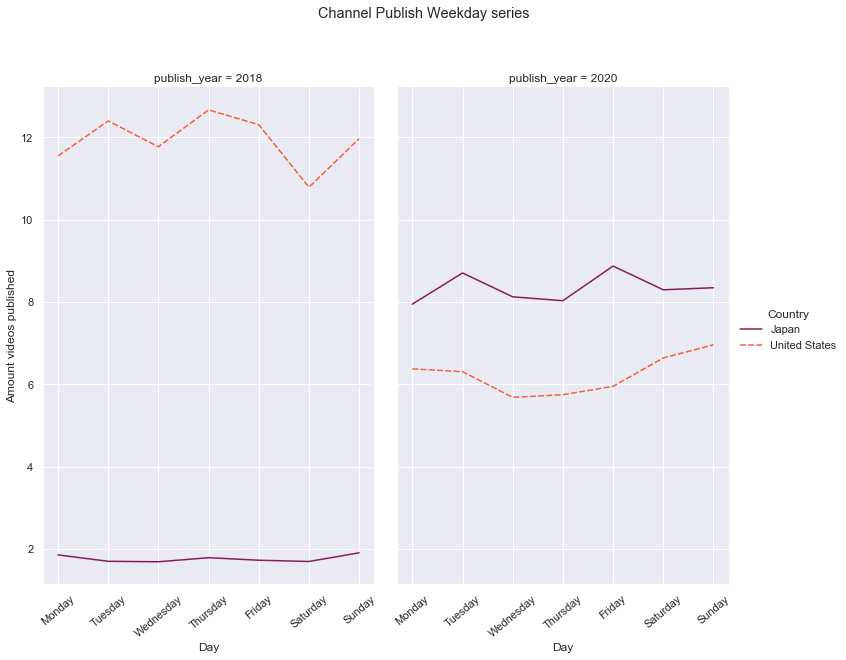

In [ ]:
channel_youtube_day = df.copy()
channel_youtube_day['publish_day_week'] = pd.to_datetime(df['publishedAt']).dt.dayofweek
channel_youtube_day['publish_day_name'] = df['publish_datetime'].dt.day_name()
agg_channel_country_day = channel_youtube_day.groupby(['Country','channelTitle','publish_year','publish_day_week','publish_day_name']).agg({'video_id':'count'}).sort_values(by='publish_day_week')
g_channel_day = sns.relplot(x='publish_day_name', y='video_id', data = agg_channel_country_day, kind='line' , hue='Country',style='Country',col='publish_year', ci=None, palette='rocket')
g_channel_day.fig.suptitle('Channel Publish Weekday series', y=1.06)
g_channel_day.set(xlabel='Day', ylabel='Amount videos published')
g_channel_day.set_xticklabels(rotation=40)
g_channel_day.fig.set_size_inches(11.7, 8.27)

#### Channel Publish Day for Japan

We are going to use the jp_youtube dataframe which has the publish date formatted to Asia/Japan timezone (9 more hours). We will do similar steps from the previous analysis. 

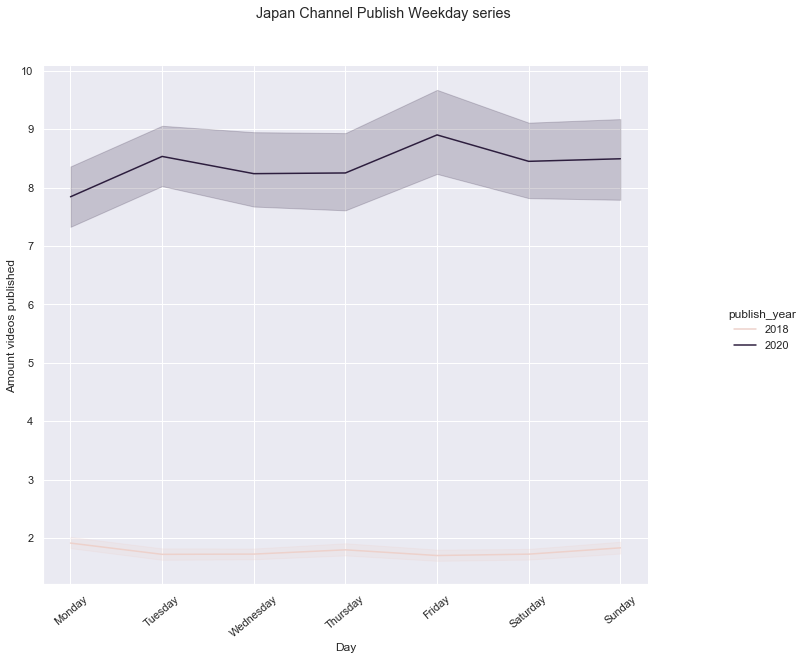

In [ ]:
jpchannel_youtube_day = jp_youtube.copy()
jpchannel_youtube_day['publish_day_week'] = pd.to_datetime(jpchannel_youtube_day['publish_date_formatted']).dt.dayofweek
jpchannel_youtube_day['publish_day_name'] = jpchannel_youtube_day['publish_date_formatted'].dt.day_name()
jp_agg_channel_country_day = jpchannel_youtube_day.groupby(['publish_year','publish_day_week','publish_day_name','channelTitle']).agg({'video_id':'count'}).sort_values(by='publish_day_week')
jp_g_channel_day = sns.relplot(x='publish_day_name', y='video_id', data = jp_agg_channel_country_day, kind='line',hue='publish_year',color='magma')
jp_g_channel_day.fig.suptitle('Japan Channel Publish Weekday series', y=1.06)
jp_g_channel_day.set(xlabel='Day', ylabel='Amount videos published')
jp_g_channel_day.set_xticklabels(rotation=40)
jp_g_channel_day.fig.set_size_inches(11.7, 8.27)

### Channel Publish Day for United States

We are going to use the us_youtube dataframe which has the publish date formatted to US/Los Angeles,CA timezone (8 hours less). We will do similar steps from the previous analysis. 

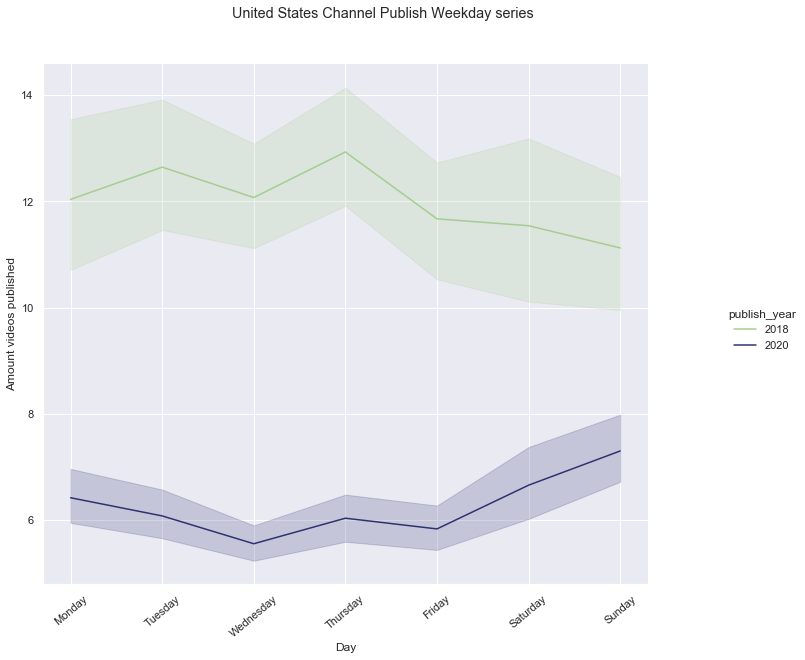

In [ ]:
uschannel_youtube_day = us_youtube.copy()
uschannel_youtube_day['publish_day_week'] = pd.to_datetime(uschannel_youtube_day['publish_date_formatted']).dt.dayofweek
uschannel_youtube_day['publish_day_name'] = uschannel_youtube_day['publish_date_formatted'].dt.day_name()
us_agg_channel_country_day = uschannel_youtube_day.groupby(['publish_year','publish_day_week','publish_day_name','channelTitle']).agg({'video_id':'count'}).sort_values(by='publish_day_week')
us_g_channel_day = sns.relplot(x='publish_day_name', y='video_id', data = us_agg_channel_country_day, kind='line',hue='publish_year',palette='crest')
us_g_channel_day.fig.suptitle('United States Channel Publish Weekday series', y=1.06)
us_g_channel_day.set(xlabel='Day', ylabel='Amount videos published')
us_g_channel_day.set_xticklabels(rotation=40)
us_g_channel_day.fig.set_size_inches(11.7, 8.27)

## Trending Time for Channels

We searched how many days takes channels to go trending since they were published and group them by each day.

Text(0.5, 0.98, 'Channels Days to go trending vs Country')

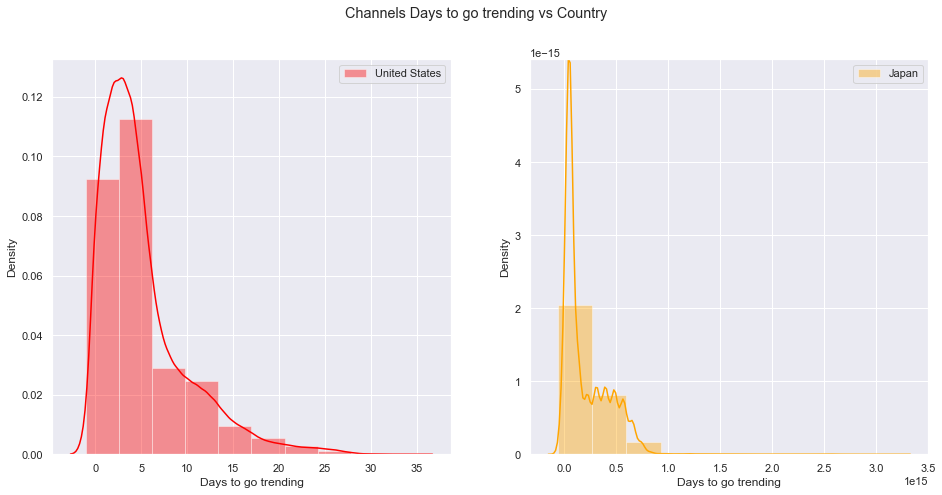

In [ ]:
fig, ax = plt.subplots(1,2,figsize=(15.7,7.27))
df_channels = df.copy()
df_channels_trend = df_channels[df_channels['Country'] == 'United States']
df_channels_trend = df_channels_trend[['channelTitle','days_to_go_trending','publish_year','Country']]
df_channels_trend['days_to_go_trending'] = df_channels_trend['days_to_go_trending'].astype('timedelta64[D]').astype(int)
g_channels_trend = sns.distplot(df_channels_trend['days_to_go_trending'],label='United States', ax=ax[0], bins=10, color='red')
g_channels_trend.set(xlabel='Days to go trending')
g_channels_trend.legend(loc="upper right")
df_channels_trend = df_channels[df_channels['Country'] == 'Japan']
g_channels_trend1 = sns.distplot(df_channels_trend['days_to_go_trending'],label='Japan',ax=ax[1], bins=10, color='orange')
g_channels_trend1.set(xlabel='Days to go trending')
g_channels_trend1.legend(loc="upper right")          
fig.suptitle('Channels Days to go trending vs Country')

As presented, US channels takes more days to go trending compared to Japan. Japan takes from 0-3.5 days, however, US channels can go from 0 to 35 days.

## Conlusion

After analyzing from general user interactions to specific categories, channels, and timelines, a big picture of video’s general characteristic, as well as similarities and differences between American and Japanese videos, could be easily seen.
For general features of videos, a typical trending video earn between 100K and 1M total views; receive 1 comment and 4 likes per 100 view, spend 2 to 3 days to go trending.
For the variation between 2 countries, similar features are listed below:

-  Both groups of viewers prefer to watch Korean music, entertainment, and gaming videos.
-  YouTubers from both countries often publish videos in early morning or late afternoon.
- In 2020, YouTubers from both countries often publish videos on weekend.
-  In 2020, published videos from both countries all spend around 3 to 4 days to go trending on average.
-  YouTube audience from two countries are all familiar with Instagram, Facebook, and Twitter based on the findings from common words searching.

For the variation between 2 countries, difference between two countries are as follows:

-  American viewers watch more movies, football, and Tumblr, while Japanese viewers are fond of manga series and baseball.
-  For social media preference, Japanese could be more used to Yahoo and TikTok based on the findings from common words searching.
-  Videos from the US earn more likes and dislikes on average compare to Japanese videos.
-  In 2018, American YouTubers prefer to publish videos on weekdays. Preferred published time for Japanese YouTubers remains unclear but there might be a preference for weekends
-  In 2018, published videos in Japan spend less than 1 day to go trending on average, while published videos in the US spend around 6 days to go trending on average.
-  In 2020, Japanese viewers are more attracted by science and technology videos than American viewers.
- Overall, US channels takes more time to go trending than Japan channels

With the help of data analytics methods, we could discover what a typical trending video looks like, what people in two countries prefer to watch, when the video probably publishes, and how long a video will go trending. We could also decipher the similarities and differences between two countries, U.S.A. and Japan, as well as two years, 2018 and 2020. It is surprising that data analysis could go this far. Right? 